# Breast Cancer Detection from Ultrasound Images using base unet and its differential analysis using rectangle box approach using open cv libraries

❓ **About the problem** <br>
❤ Breast cancer is the most diagnosed cancer among women worldwide, accounting for 1 in 4 cancer cases.<br>
❤ Breast cancer cells usually form a tumour that can often be seen on an x-ray or felt as a lump.

📔**Introduction** <br>

The goal of **semantic image segmentation** is to label each pixel of an image with a corresponding class of what is being represented. Because we’re predicting for every pixel in the image, this task is commonly referred to as *dense prediction*.
The **output** itself is a high resolution image (typically of the same size as input image) in which each pixel is classified to a particular class.<br>

🗒 About the datset

The data collected at baseline include breast ultrasound images among women in ages between 25 and 75 years old. This data was collected in 2018. The number of patients is 600 female patients. The dataset consists of 780 images with an average image size of 500*500 pixels. The images are in PNG format. The ground truth images are presented with original images. The images are categorized into three classes, which are normal, benign, and malignant.

↪ Dataset Link : [Breast Ultrasound Image Dataset](https://www.kaggle.com/datasets/aryashah2k/breast-ultrasound-images-dataset)

**Step 1: Import Libraries**

In [1]:
import os
import sys
import random

import numpy as np
import pandas as pd
import tensorflow as tf


import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

from PIL import Image
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras import layers
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import SGD, schedules, Adam
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.models import Model, load_model
from tensorflow.python.keras import losses

from keras import backend as K

In [2]:
from __future__ import print_function

import glob
from skimage.io import imsave
from keras.models import Model
from keras.layers import Lambda, Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose, UpSampling2D ,BatchNormalization, Add, Activation
from tensorflow.keras.optimizers import Adam, Adadelta
from keras.layers.merge import add,multiply
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
# import tensorflow.keras.backend as K
import matplotlib.pyplot as plt
#from data import load_train_data, load_test_data
from sklearn.model_selection import train_test_split
K.set_image_data_format('channels_last')  # TF dimension ordering in this code


img_rows = 256
img_cols = 256
smooth = 1.

In [3]:
!pip install imutils

  Preparing metadata (setup.py) ... done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25860 sha256=3c48ff2d7ab357968ed27f8fa1b9c91411c6de2da4afc621c01d05048f7cef71
  Stored in directory: /root/.cache/pip/wheels/86/d7/0a/4923351ed1cec5d5e24c1eaf8905567b02a0343b24aa873df2
Successfully built imutils


In [4]:
import glob
import cv2
# import the necessary packages
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import matplotlib.pyplot as plt
import numpy as np
import imutils
import os
import pandas as pd

In [5]:
from PIL import Image

**Step 2: Load Dataset**

In [6]:
image_height = 256
image_width = 256
dpath = "../input/breast-ultrasound-images-dataset/Dataset_BUSI_with_GT/"
classes = ['benign', 'malignant', 'normal']

In [7]:
data = {'image' : [],
        'mask' : []}

**Step 3: Data Preprocessing**

In [8]:
def load_data(path, data_obj, class_name):
    img_names_list = os.listdir(path+class_name)
    image_names = []
    mask_names = []
    names_truncated = []
    
    for i in range(len(img_names_list)):
        names_truncated.append(img_names_list[i].split(')')[0])
    
    names_truncated = list(set(names_truncated))
    for i in range(len(names_truncated)):
        image_names.append(names_truncated[i]+').png')
        mask_names.append(names_truncated[i]+')_mask.png')
    
    data_obj = preprocess_data(image_names, mask_names, image_width, image_height, path, class_name, data_obj)
        
        
    return data_obj
    

In [9]:
def preprocess_data(image_names, mask_names, img_width, img_height, dpath, dclass, data_obj):
    for index in range (len(image_names)):
#         img = plt.imread(dpath+'/'+dclass+'/'+ image_names[index])
#         mask = plt.imread(dpath+'/'+dclass+'/'+ mask_names[index])

#         img = cv2.resize(img, (img_width, img_height)) 
#         mask = cv2.resize(mask, (img_width, img_height))
        
#         mask = np.expand_dims(mask, -1)

        image_path = dpath+'/'+dclass+'/'+ image_names[index]
        mask_path = dpath+'/'+dclass+'/'+ mask_names[index]
        
        x = cv2.imread(image_path, cv2.IMREAD_COLOR)
        x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)
        x = np.round(cv2.resize(x, (image_height, image_width)))
        x.dtype = np.uint8
        y = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        y = cv2.resize(y, (image_height, image_width))

        x= x/255.0
        y= y/255.0
        data_obj['image'].append(x)
        data_obj['mask'].append(y)

    return data_obj

In [10]:
data = load_data(dpath, data, classes[0]) 
ln = len(data['image'])
print("Number of benign tumor images", ln)
data = load_data(dpath, data, classes[1]) 
print("Number of malignant tumor images", len(data['image'])-ln)
print("Total images for segmentation", len(data['image']))

Number of benign tumor images 437
Number of malignant tumor images 210
Total images for segmentation 647


**Step 5: Visualization**

In [11]:
def visualize_example(data, index = None):
    if index is None:
        index = random.randint(0, len(data['image']))
    X = data['image']
    y = data['mask']
    has_mask = y[index].max() > 0
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(X[index])
    if has_mask:
        ax[0].contour(y[index].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[index].squeeze())
    ax[1].set_title('Mask')
    #ax[1].savefig(m_out)
    
    # code for save fig only the mask image
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[1].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('ax2_figure.png', bbox_inches=extent)

    # Pad the saved area by 10% in the x-direction and 20% in the y-direction
    #fig.savefig('ax2_figure_expanded.png', bbox_inches=extent.expanded(1.1, 1.2))

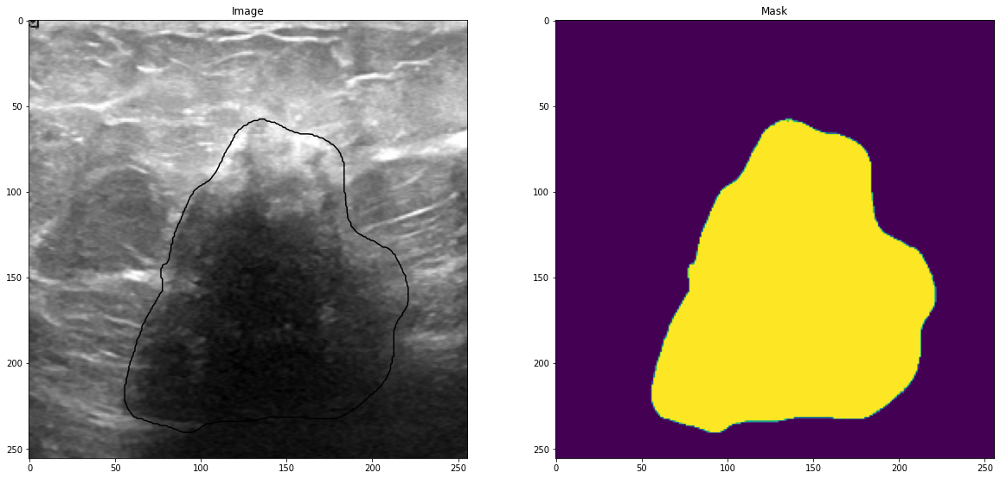

In [12]:
visualize_example(data)

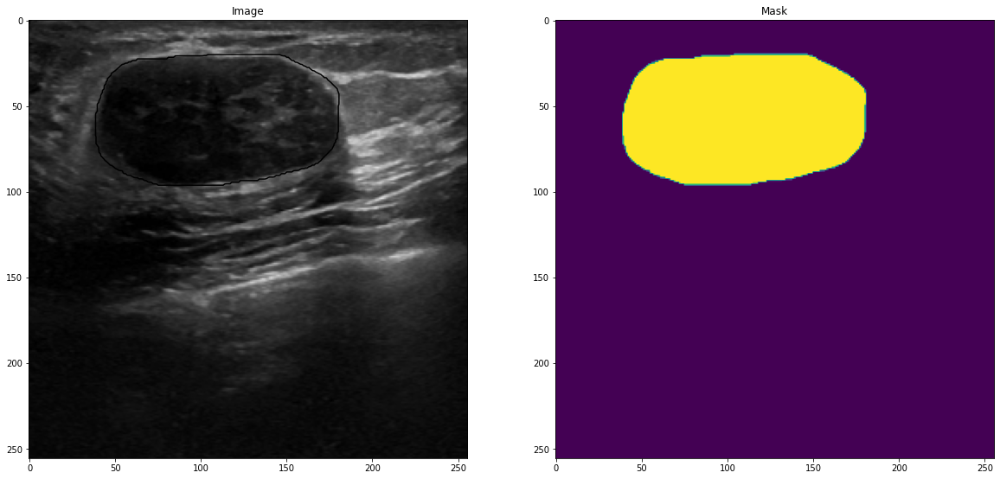

In [13]:
visualize_example(data,index=0)

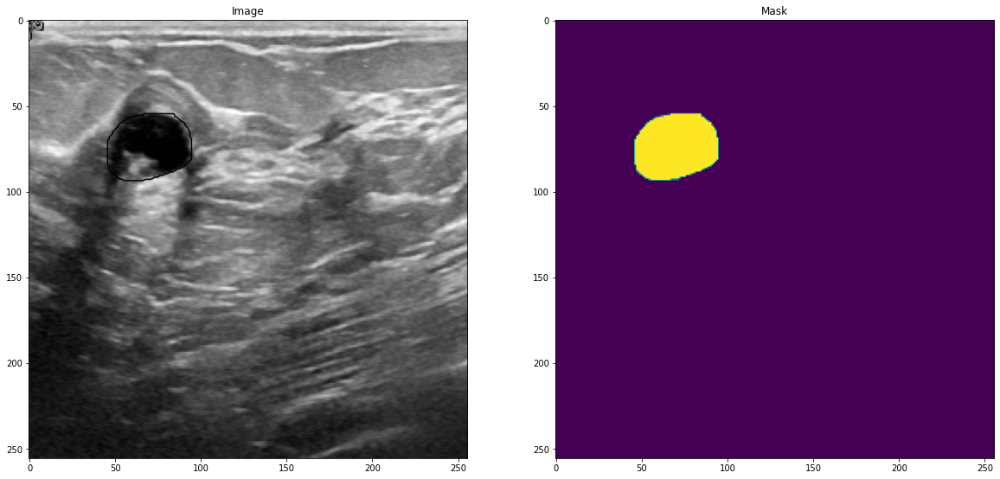

In [14]:
visualize_example(data,index=14)

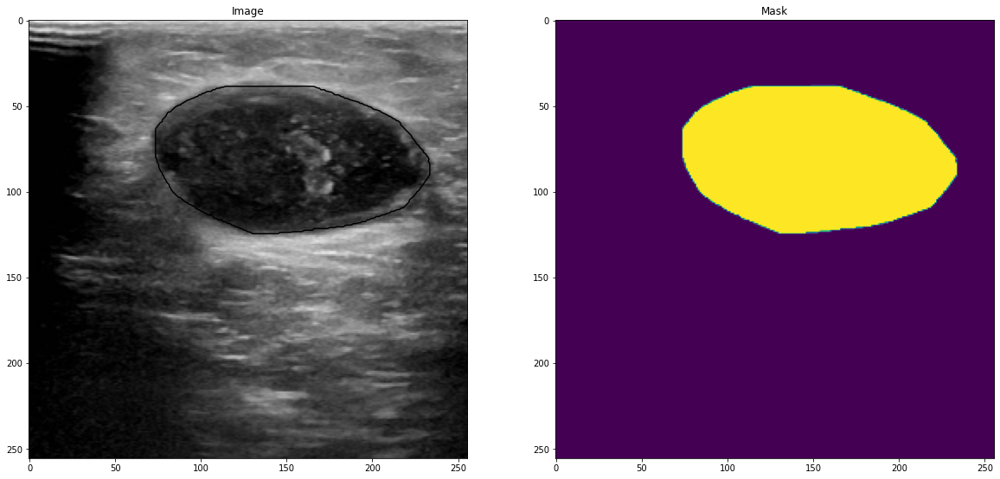

In [15]:
visualize_example(data,index=210)

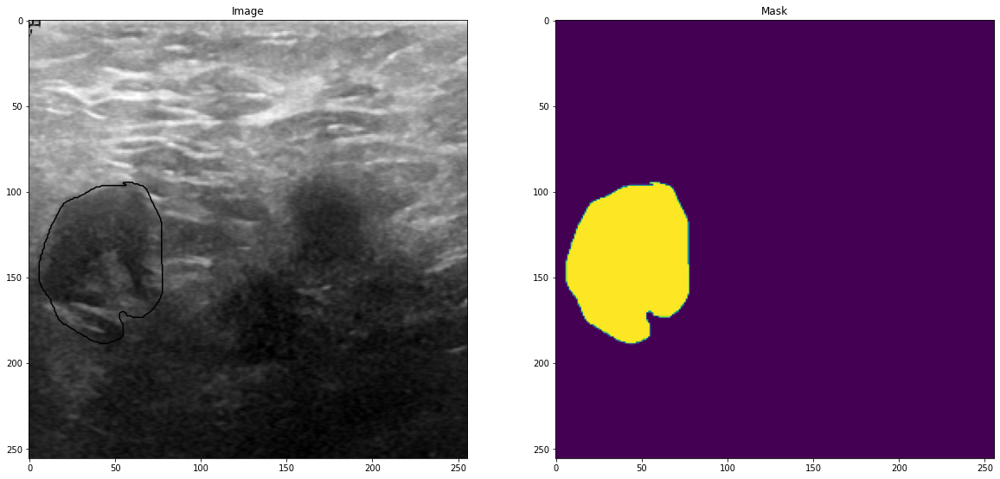

In [16]:
visualize_example(data,index=646)

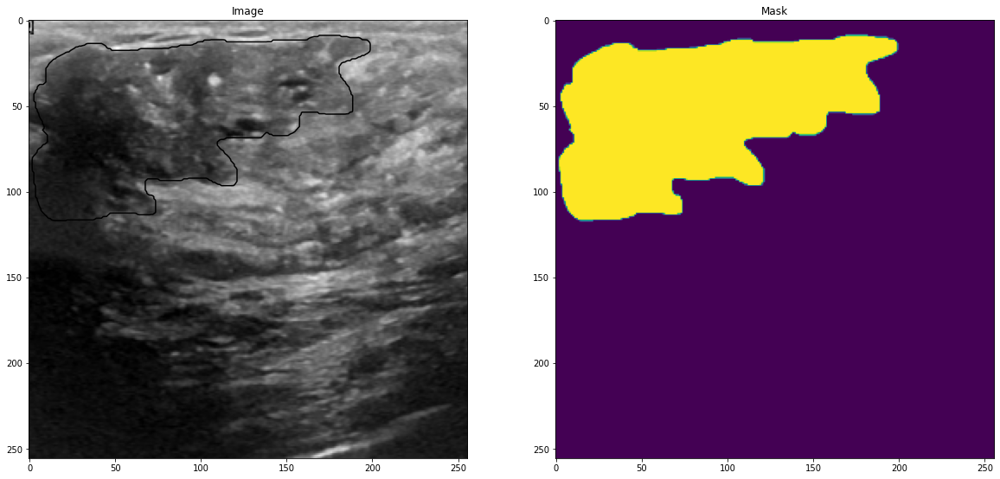

In [17]:
visualize_example(data,index=437)

In [18]:
data['image'] = np.array(data['image'])
data['image'].shape

(647, 256, 256, 3)

In [19]:
data['mask'] = np.array(data['mask'])
data['mask'] =  np.expand_dims(data['mask'], -1)
data['mask'].shape

(647, 256, 256, 1)

**Step 6: Train-Test Split**

In [20]:
# for all images 
X_train, X_valid, y_train, y_valid = train_test_split(data['image'], data['mask'], test_size=0.2, random_state=42)
print(len(X_train), len(y_train), len(X_valid), len(y_valid))

517 517 130 130


**Step 7: Data Augmentation**: Image data augmentation is a technique that can be used to artificially expand the size of a training dataset by creating modified versions of images in the dataset.Since the dataset only includes x images, performing data augmentation helps in preventing a neural network from learning irrelevant features. This results in better model performance.

**a)** Here we have defined a function to perform basic augmentation techniques like rotation, flipping, zooming etc.

In [21]:
data_gen_args = dict(
    rotation_range=60,
    zoom_range=[0.6,1.0],
    horizontal_flip=True,
    vertical_flip = True,
    fill_mode="nearest",
)

**b)** Here we are using the Keras deep learning neural network library that provides the capability to fit models using image data augmentation via the ImageDataGenerator class.

In [22]:
image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)
seed = 1

In [23]:
image_datagen.fit(X_train, augment=True, seed=seed)

In [24]:
mask_datagen.fit(y_train, augment=True, seed=seed)

**Step 8: Fitting and Creating Train Generator**

In [25]:
image_generator = image_datagen.flow(
    X_train,
    batch_size = 16,
    seed=seed)
mask_generator = mask_datagen.flow(
    y_train,
    batch_size = 16,
    seed=seed)

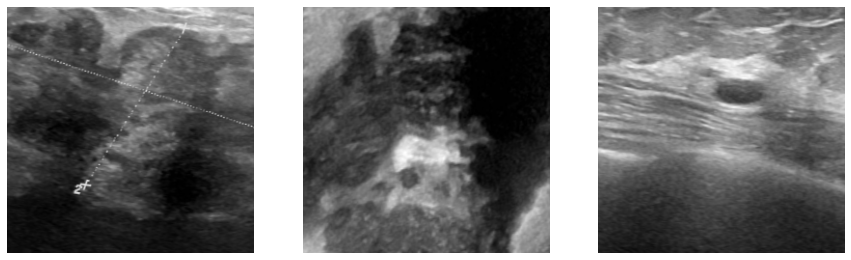

In [26]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(image_generator)[0]
    ax[i].imshow(image)
    ax[i].axis('off')

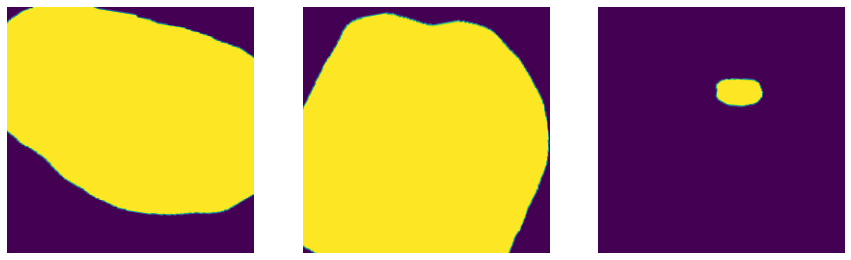

In [27]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(mask_generator)[0]
    #print(image)
    ax[i].imshow(image)
    ax[i].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[i].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('axi_figure.png', bbox_inches=extent)
    
    
    
    

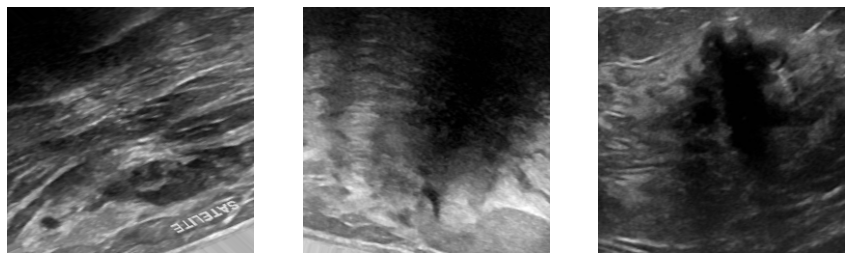

In [28]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(image_generator)[1]
    ax[i].imshow(image)
    ax[i].axis('off')

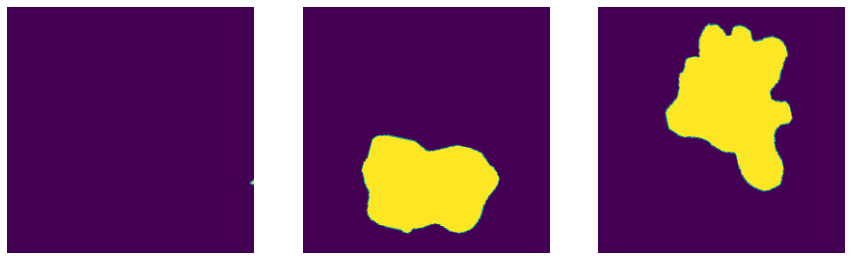

In [29]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(mask_generator)[1]
    ax[i].imshow(image)
    ax[i].axis('off')

In [30]:
train_generator = zip(image_generator, mask_generator)

In [31]:
tf.keras.backend.clear_session()

**Step 9: Defining Loss Functions** In cross entropy loss, the loss is calculated as the average of per-pixel loss, and the per-pixel loss is calculated discretely, without knowing whether its adjacent pixels are boundaries or not.As a result, cross entropy loss only considers loss in a micro sense rather than considering it globally, which is not enough for image level prediction.<br>
![](https://miro.medium.com/max/1050/1*VMiADFOL7x0R9U32qK-C6Q.png)

**Dice loss** originates from *Sørensen–Dice coefficient*, which is a statistic developed in 1940s to gauge the similarity between two samples.Dice loss considers the loss information both locally and globally, which is critical for high accuracy.<br>
![](https://miro.medium.com/max/386/1*EF3VCtk-VbTIKhriaQF0YQ.png)<br>
Here,<br>
**pi,gi** : pairs of corresponding pixel values of prediction and ground truth<br>
*In boundary detection scenario, the values of pi and gi are either 0 or 1, representing whether the pixel is boundary (value of 1) or not (value of 0).*<br>
Therefore, the denominator is the sum of total boundary pixels of both prediction and ground truth, and the numerator is the sum of correctly predicted boundary pixels because the sum increments only when pi and gi match (both of value 1).

In [32]:
def dice_coeff(y_true, y_pred):
    smooth = 1.
    # Flatten
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    score = (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)
    return score

In [33]:
def dice_loss(y_true, y_pred):
    loss = 1 - dice_coeff(y_true, y_pred)
    return loss

In [34]:
def bce_dice_loss(y_true, y_pred):
    loss = losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)
    return loss

In [35]:
def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3])+K.sum(y_pred,[1,2,3])-intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

**Step 10: Building U-net Model**

**About U-net:** The UNET was developed by Olaf Ronneberger et al. for Bio Medical Image Segmentation. <br>
The architecture contains two paths. First path is the contraction path (also called as the encoder) which is used to capture the context in the image. The encoder is just a traditional stack of convolutional and max pooling layers. The second path is the symmetric expanding path (also called as the decoder) which is used to enable precise localization using transposed convolutions. Thus it is an end-to-end fully convolutional network (FCN), i.e. it only contains Convolutional layers and does not contain any Dense layer because of which it can accept image of any size.<br>
![](https://www.researchgate.net/publication/331406702/figure/fig2/AS:731276273262594@1551361258173/Illustration-of-the-U-net-architecture-The-figure-illustrates-the-U-net-architecture.png)

original code

In [36]:
def conv2d_block(input_tensor, n_filters=16, kernel_size = 3, batchnorm = True):
    # first layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    # second layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    return x

In [37]:


def get_unet(input_img, n_filters = 16, dropout = 0.1, batchnorm = True):
    # Contracting Path
    c1 = conv2d_block(input_img, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)
    p1 = MaxPooling2D((2, 2))(c1)
    p1 = Dropout(dropout)(p1)
    
    c2 = conv2d_block(p1, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)
    p2 = MaxPooling2D((2, 2))(c2)
    p2 = Dropout(dropout)(p2)
    
    c3 = conv2d_block(p2, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)
    p3 = MaxPooling2D((2, 2))(c3)
    p3 = Dropout(dropout)(p3)
    
    c4 = conv2d_block(p3, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)
    p4 = MaxPooling2D((2, 2))(c4)
    p4 = Dropout(dropout)(p4)
    
    c5 = conv2d_block(p4, n_filters = n_filters * 16, kernel_size = 3, batchnorm = batchnorm)
    
    # Expansive Path
    u6 = Conv2DTranspose(n_filters * 8, (3, 3), strides = (2, 2), padding = 'same')(c5)
    u6 = concatenate([u6, c4])
    u6 = Dropout(dropout)(u6)
    c6 = conv2d_block(u6, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)
    
    u7 = Conv2DTranspose(n_filters * 4, (3, 3), strides = (2, 2), padding = 'same')(c6)
    u7 = concatenate([u7, c3])
    u7 = Dropout(dropout)(u7)
    c7 = conv2d_block(u7, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)
    
    u8 = Conv2DTranspose(n_filters * 2, (3, 3), strides = (2, 2), padding = 'same')(c7)
    u8 = concatenate([u8, c2])
    u8 = Dropout(dropout)(u8)
    c8 = conv2d_block(u8, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)
    
    u9 = Conv2DTranspose(n_filters * 1, (3, 3), strides = (2, 2), padding = 'same')(c8)
    u9 = concatenate([u9, c1])
    u9 = Dropout(dropout)(u9)
    c9 = conv2d_block(u9, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
    model = Model(inputs=[input_img], outputs=[outputs])
    return model

In [38]:
img_rows = 256
img_cols = 256

**Step 11: Setting up Hyperparameters**

In [39]:
input_layer= Input((image_height, image_width, 3), name='img')
unet_model = get_unet(input_layer,dropout=0.05, batchnorm=True)
unet_model.summary()

2022-11-09 10:01:19.849033: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 10:01:19.850048: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 10:01:20.087290: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 10:01:20.088207: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 10:01:20.089045: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img (InputLayer)                [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 16) 448         img[0][0]                        
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 256, 256, 16) 64          conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 256, 256, 16) 0           batch_normalization_1[0][0]      
______________________________________________________________________________________________

In [40]:

unet_model.compile(Adam(learning_rate=0.001),
                  loss= bce_dice_loss,
                  metrics=[dice_loss, dice_coeff, iou_coef,'accuracy'])

In [41]:
callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.0003, verbose=1),
    ModelCheckpoint('model-checkpoint.h5', verbose=1, save_best_only=True, save_weights_only=True) ]

In [42]:
batch_size = 4
#epochs = 2
epochs = 50

**Step 12: Training the model**

In [43]:
model_history = unet_model.fit(train_generator,  
                    batch_size=batch_size, 
                    steps_per_epoch=int(np.ceil(len(X_train) / float(batch_size))),
                    epochs=epochs, 
                    callbacks=callbacks,
                    validation_data=(X_valid, y_valid),
                    verbose = 1)

2022-11-09 10:01:26.065555: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/50


2022-11-09 10:01:30.544206: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


130/130 [==============================] - 61s 331ms/step - loss: 1.1551 - dice_loss: 0.6955 - dice_coeff: 0.3045 - iou_coef: 0.1560 - accuracy: 0.8000 - val_loss: 2.5713 - val_dice_loss: 0.7756 - val_dice_coeff: 0.2244 - val_iou_coef: 0.1279 - val_accuracy: 0.4100

Epoch 00001: val_loss improved from inf to 2.57132, saving model to model-checkpoint.h5
Epoch 2/50
130/130 [==============================] - 41s 314ms/step - loss: 0.9525 - dice_loss: 0.6153 - dice_coeff: 0.3847 - iou_coef: 0.2040 - accuracy: 0.8632 - val_loss: 0.9257 - val_dice_loss: 0.6975 - val_dice_coeff: 0.3025 - val_iou_coef: 0.1567 - val_accuracy: 0.9283

Epoch 00002: val_loss improved from 2.57132 to 0.92568, saving model to model-checkpoint.h5
Epoch 3/50
130/130 [==============================] - 41s 314ms/step - loss: 0.8863 - dice_loss: 0.5699 - dice_coeff: 0.4301 - iou_coef: 0.2385 - accuracy: 0.8699 - val_loss: 0.7441 - val_dice_loss: 0.5496 - val_dice_coeff: 0.4504 - val_iou_coef: 0.2557 - val_accuracy: 0.929

**Step 13: Learning Curve Visualization**


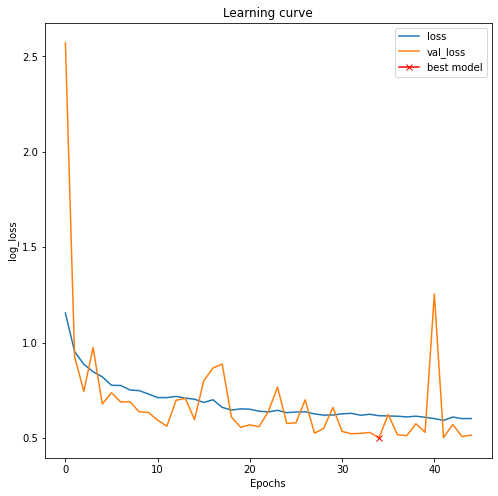

In [44]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(model_history.history["loss"], label="loss")
plt.plot(model_history.history["val_loss"], label="val_loss")
plt.plot( np.argmin(model_history.history["val_loss"]), np.min(model_history.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

**Step 14: Evaluating the model on test sets**

In [45]:
unet_model.load_weights('model-checkpoint.h5')
unet_model.evaluate(X_valid, y_valid, verbose=1)

5/5 [==============================] - 2s 57ms/step - loss: 0.4992 - dice_loss: 0.4068 - dice_coeff: 0.5932 - iou_coef: 0.4138 - accuracy: 0.9456


[0.4991624653339386,
 0.4068378508090973,
 0.5931621789932251,
 0.4137842655181885,
 0.9456203579902649]

In [46]:
ev = unet_model.evaluate(X_valid, y_valid, verbose=1)

5/5 [==============================] - 0s 59ms/step - loss: 0.4992 - dice_loss: 0.4068 - dice_coeff: 0.5932 - iou_coef: 0.4138 - accuracy: 0.9456


In [47]:
print(ev[1])

0.4068378508090973


In [48]:
preds_test = unet_model.predict(X_valid, verbose=1)
preds_test_t = (preds_test > 0.75).astype(np.uint8)

5/5 [==============================] - 1s 60ms/step


In [49]:
#Visualization of Predicted Mask

In [50]:
import io
from PIL import Image
import matplotlib.pyplot as plt

In [51]:

def plot_sample(X, y, preds, binary_preds, ix=None):
    #area = []
    #index = []
    if ix is None:
        ix = random.randint(0, len(X))
    print("test image:",ix)
    has_mask = y[ix].max() > 0
    fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    ax[0].imshow(X[ix])
    if has_mask:
        ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[ix].squeeze(), vmin=0, vmax=1)
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    ax[1].set_title('Mask')
    
    #ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    ax[2].set_title('Mask Predicted')
    
    ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    ax[3].set_title('Mask Predicted binary');
    
    #ax[3].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('pred_mask_bin.png', bbox_inches=extent)
    
    #ratio1 = mask_ratio(preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    
    #area_ratio_mask.append(ratio)
    #area_ratio_pred_mask.append(ratio1)
    #index.append(i)

test image: 127


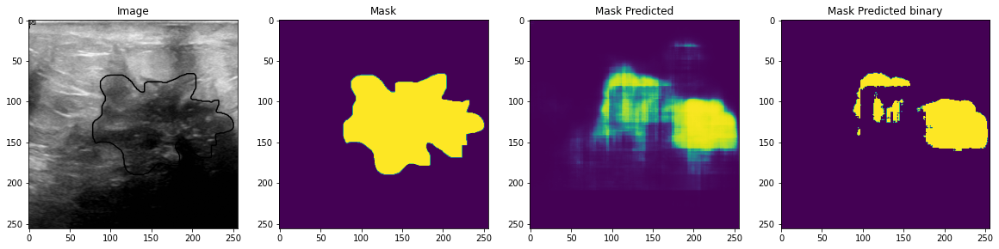

In [52]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 83


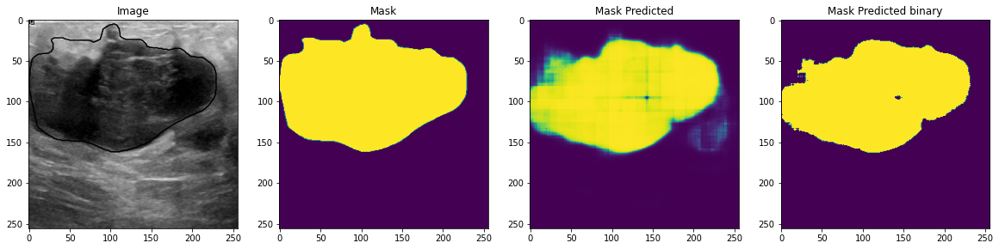

In [53]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=83)

test image: 84


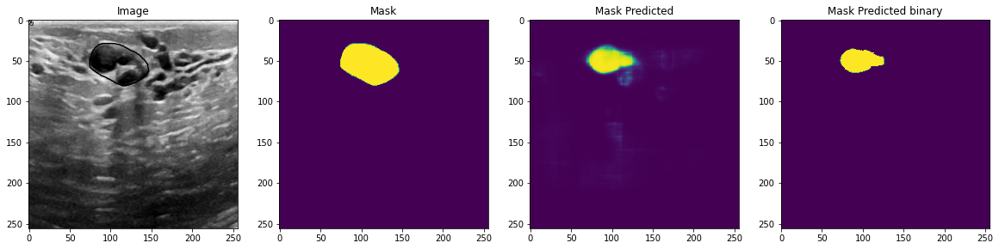

In [54]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=84)

test image: 85


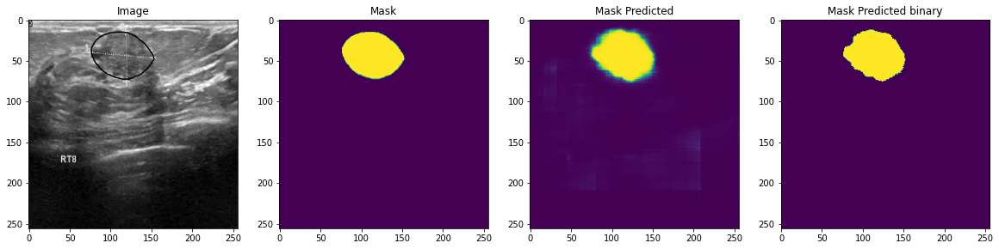

In [55]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=85)

test image: 37


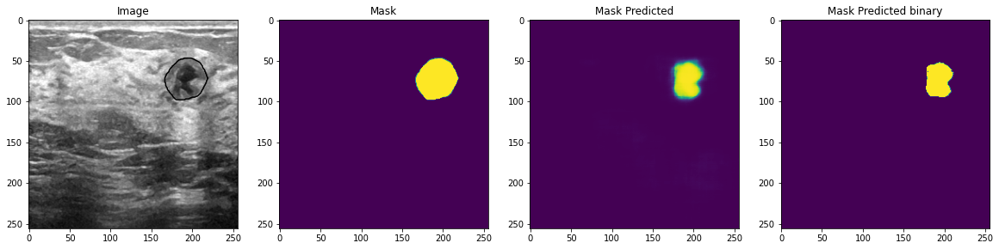

In [56]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 47


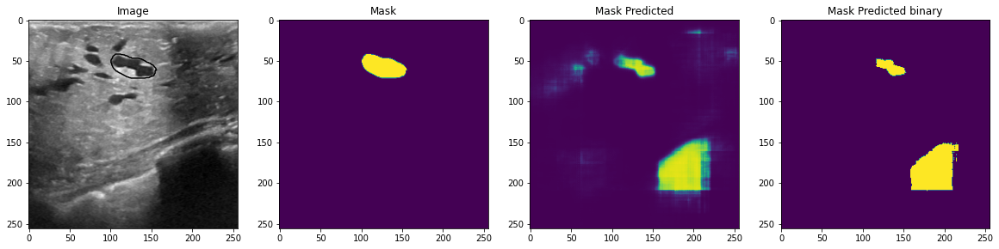

In [57]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=47)

test image: 87


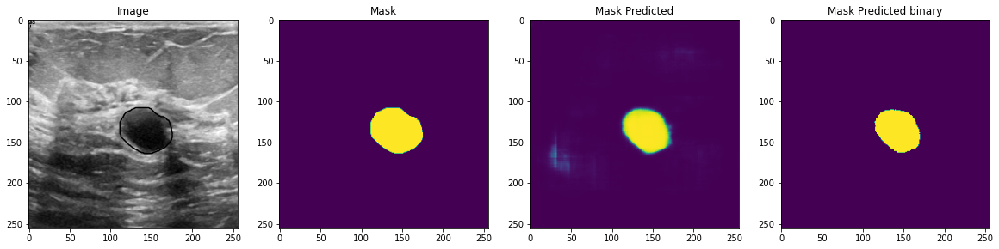

In [58]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 23


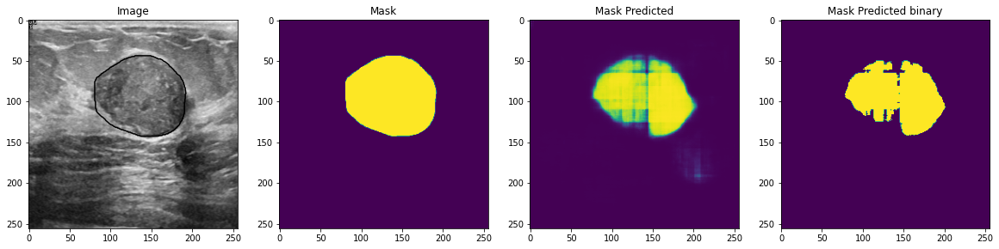

In [59]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 29


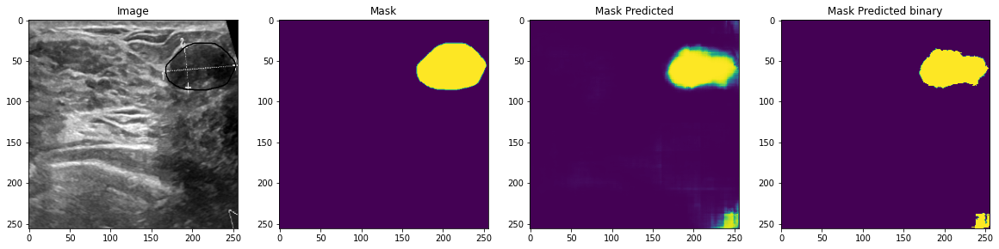

In [60]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 87


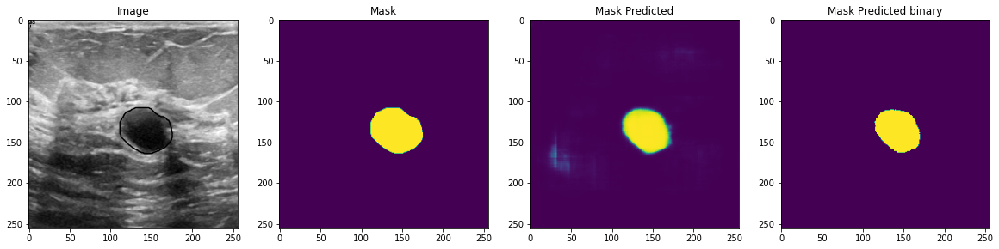

In [61]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 113


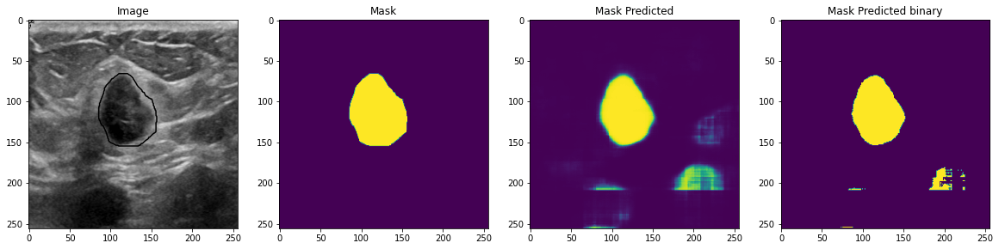

In [62]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 72


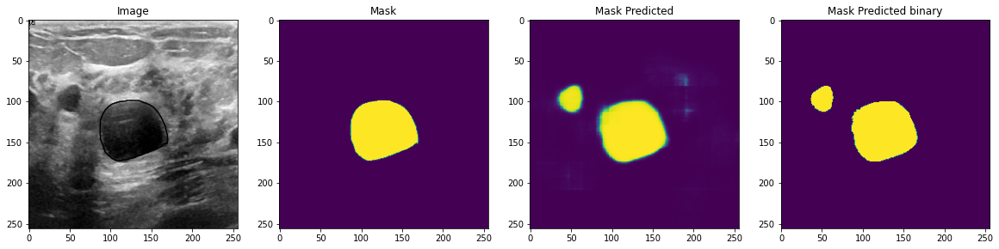

In [63]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 13


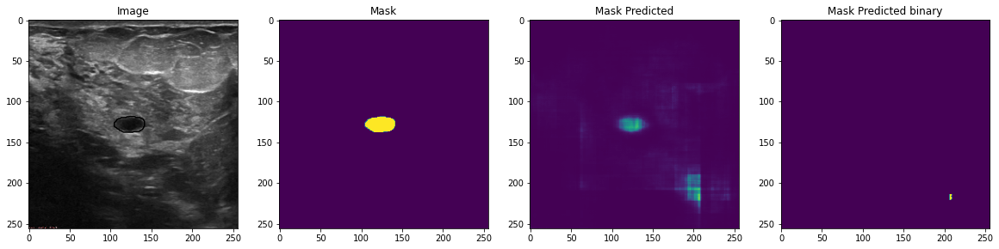

In [64]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

In [65]:
# Function for  white_pixel_area_ratio

In [66]:
def mask_ratio(img):
    cv2.imwrite('a.png',img)
    img = cv2.imread('a.png')
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray,0,255,cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
    pixels = cv2.countNonZero(thresh)
    image_area = img.shape[0] * img.shape[1]
    area_ratio = (pixels / image_area) * 100
    return area_ratio

In [67]:
# function for rectangle box approach for calculating Area of the tumour uisng opencv library

In [68]:
def midpoint(ptA, ptB):
	return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

In [69]:
# defining an object function for measuring the size of tumour is inches assuming pixel_per_metrix as 157
# 157 pixels per every 0.955 inches in our images
# https://pyimagesearch.com/2016/03/28/measuring-size-of-objects-in-an-image-with-opencv/
def object_opencv(img):
    #print(img)
    #image = cv2.imread(img)
    cv2.imwrite('a.png',img)
    image = cv2.imread('a.png')
    #image = image[0:250, 120:432]
    #image = cv2.resize(image, (image_height, image_width))
    #image = image/255.0
    #image.dtype = np.uint8
    #image = cv2.imread('b.png')
    #print(image)
    #print(image.shape)
    #print('X')
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #print(gray.shape)
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray,0,255,cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
    #thresh = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY)[1]
    #(thresh, blackAndWhiteImage) = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
    gray = cv2.GaussianBlur(thresh, (7, 7), 0)
    #print(gray)
    #plt.imshow(thresh)
    #plt.show()
    edged = cv2.Canny(gray, 50, 100)
    edged = cv2.dilate(edged, None, iterations=1)
    edged = cv2.erode(edged, None, iterations=1)
    #print(edged.shape)
    cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    #print("1:",cnts)
    cnts = imutils.grab_contours(cnts)
    #print("2:",cnts)
    cv2.drawContours(image, cnts, -1, (0, 255, 0), 3)
    (cnts, _) = contours.sort_contours(cnts)
    #print("3:",cnts)
    for c in cnts:
        # if the contour is not sufficiently large, ignore it
        if cv2.contourArea(c) < 100:
            continue

        # compute the rotated bounding box of the contour
        orig = image.copy()
        box = cv2.minAreaRect(c)
        box = cv2.cv.BoxPoints(box) if imutils.is_cv2() else cv2.boxPoints(box)
        box = np.array(box, dtype="int")
        #print(box)
        # order the points in the contour such that they appear
        # in top-left, top-right, bottom-right, and bottom-left
        # order, then draw the outline of the rotated bounding
        # box
        box = perspective.order_points(box)
        print(box)
        cv2.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
    
        #My chnages
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()
    
        # loop over the original points and draw them
        for (x, y) in box:
            cv2.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)
        
        #My chnages
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()

        # unpack the ordered bounding box, then compute the midpoint
        # between the top-left and top-right coordinates, followed by
        # the midpoint between bottom-left and bottom-right coordinates
        (tl, tr, br, bl) = box
        (tltrX, tltrY) = midpoint(tl, tr)
        (blbrX, blbrY) = midpoint(bl, br)

        # compute the midpoint between the top-left and top-right points,
        # followed by the midpoint between the top-righ and bottom-right
        (tlblX, tlblY) = midpoint(tl, bl)
        (trbrX, trbrY) = midpoint(tr, br)

        # draw the midpoints on the image
        cv2.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)

        # draw lines between the midpoints
        cv2.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
        cv2.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)

        # compute the Euclidean distance between the midpoints
        dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
        dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
        #print("dA",dA)
        #print("dB",dB)
        #print("pixelsPerMetric",pixelsPerMetric)

        # if the pixels per metric has not been initialized, then
        # compute it as the ratio of pixels to supplied metric
        # (in this case, inches)
        #my chnages 
        #if pixelsPerMetric is None:
        #    pixelsPerMetric = dB /4.2
        pixelsPerMetric= 157
        # compute the size of the object
        dimA = dA / pixelsPerMetric
        dimB = dB / pixelsPerMetric
        print("dimA",dimA)
        print("dimB",dimB)
      
        #length = []
        #width = []
        #length.append(dimA)
        #width.append(dimB)
        # draw the object sizes on the image
        cv2.putText(orig, "{:.1f}in".format(dimB),(int(tltrX - 15), int(tltrY - 10)), cv2.FONT_HERSHEY_SIMPLEX,0.65, (200, 100, 100), 2)
        cv2.putText(orig, "{:.1f}in".format(dimA),(int(trbrX - 50), int(trbrY)), cv2.FONT_HERSHEY_SIMPLEX,0.65, (200, 100, 100), 2)

        # show the output image
        #orig = cv2.resize(orig, (0,0),fx=.55,fy=1)
        #orig= cv2.resize(orig, (900, 200))
        #plt.imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
        plt.imshow(orig)
        plt.show()
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()
        #return length,width
        return dimA,dimB,tl,tr,bl,br
    

In [70]:
index = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
    #pred_img = []
    #pred_mask_img = []
area_ratio_mask = []
area_ratio_pred_mask = []

In [71]:

    
def plot_sample4(X, y, preds, binary_preds, ix=None):
  
    if ix is None:
        ix = random.randint(0, len(X))
    print("test image:",ix)
    has_mask = y[ix].max() > 0
    fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    ax[0].imshow(X[ix])
    if has_mask:
        ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[ix].squeeze())
    print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    ax[1].set_title('Mask')
    
    ratio = mask_ratio(y[ix])
    print("area ratio of ground truth",ratio)

    ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    ax[2].set_title('Mask Predicted')
    
    
    
    ax[3].imshow(binary_preds[ix])
    #ax[3].set_title('Mask Predicted binary');
    
    ax[3].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    extent = ax[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    fig.savefig('pred_mask_bin.png', bbox_inches=extent)
    image1 = cv2.imread('pred_mask_bin.png')
    image1 = image1[150:390,:]
    ratio1 = mask_ratio(image1)
    area_ratio_mask.append(ratio)
    area_ratio_pred_mask.append(ratio1)
    index.append(ix)
    print("area ratio of mask predicted by model",ratio1)
    if ((ratio1 != 100) & (ratio1 >= 1)) :
        len1,wid,tl,tr,bl,br = object_opencv(image1)
        length.append(len1)
        width.append(wid)
        top_left.append(tl)
        top_right.append(tr)
        bottom_left.append(bl)
        bottom_right.append(br)
        



def plot_sample1(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    #ax[0].imshow(X[ix])
    #if has_mask:
    #    ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    #ax[0].set_title('Image')

    #ax[1].imshow(y[ix].squeeze())
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    #ax[1].set_title('Mask')
    
    ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    #ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[2].set_title('Mask Predicted')
    
    #ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[3].set_title('Mask Predicted binary');
    
    ratio1 = mask_ratio(preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    #print(preds[ix])
    pred_mask_img.append(binary_preds[ix])
    pred_img.append(preds[ix])
    area_ratio_mask.append(ratio)
    area_ratio_pred_mask.append(ratio1)
    index.append(i)

pred_img = []
pred_mask_img = []
area_ratio_mask = []
area_ratio_pred_mask = []

index = []
for i in range (0,len(X_valid)):
    plot_sample1(X_valid, y_valid, preds_test, preds_test_t,ix=i)
    

test image: 0
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.1685791015625
area ratio of mask predicted by model 0.24965564738292012
test image: 1
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 31.00433349609375
area ratio of mask predicted by model 30.88326446280992
[[ 11.   7.]
 [244.  15.]
 [239. 136.]
 [  7. 127.]]
dimA 0.7680509275242646
dimB 1.4818810475215651


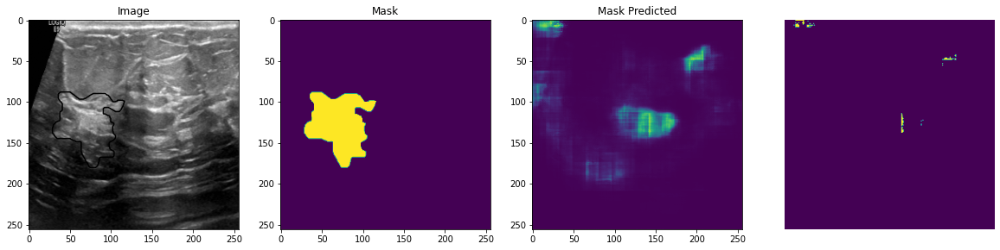

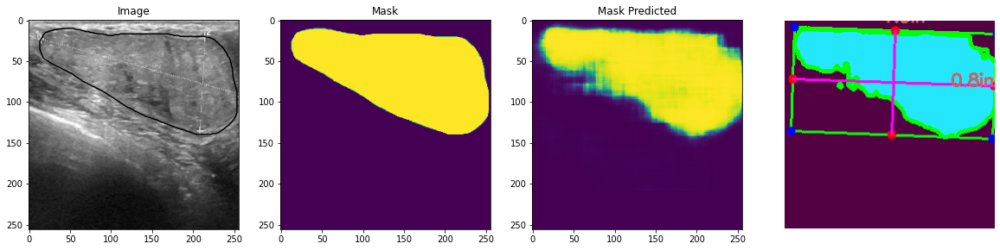

test image: 2
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.526611328125
area ratio of mask predicted by model 100.0
test image: 3
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.73138427734375
area ratio of mask predicted by model 13.710399449035812
[[ 63.  45.]
 [189.  45.]
 [189. 128.]
 [ 63. 128.]]
dimA 0.5286624203821656
dimB 0.802547770700637


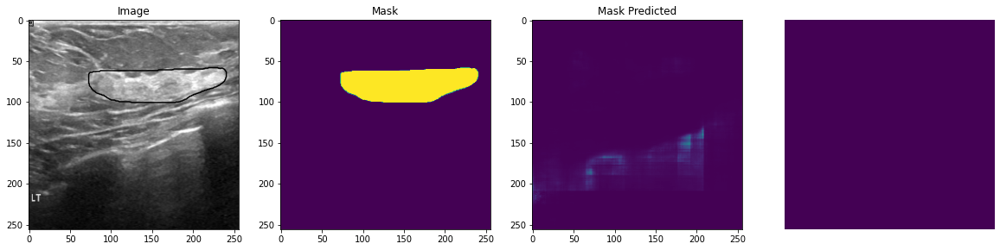

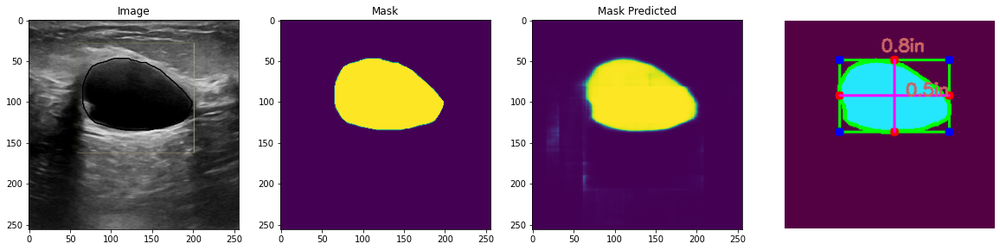

test image: 4
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.51263427734375
area ratio of mask predicted by model 16.983471074380166
[[ 38.  19.]
 [234.  19.]
 [234.  90.]
 [ 38.  90.]]
dimA 0.45222929936305734
dimB 1.2484076433121019


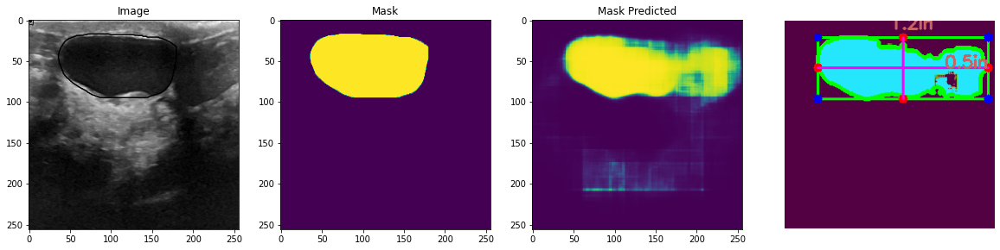

test image: 5
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 20.79010009765625
area ratio of mask predicted by model 0.9865702479338844
test image: 6
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.87005615234375
area ratio of mask predicted by model 5.18767217630854
[[133.  28.]
 [209.  28.]
 [209.  82.]
 [133.  82.]]
dimA 0.34394904458598724
dimB 0.4840764331210191


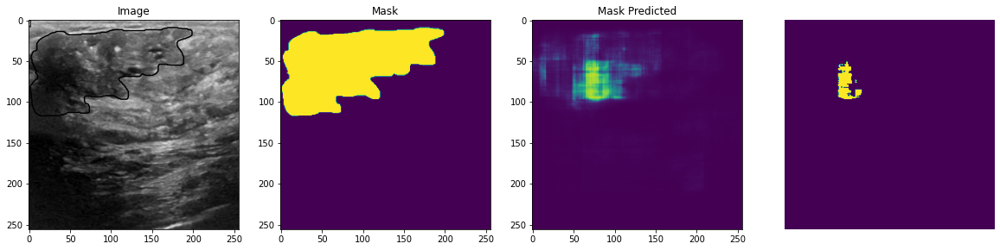

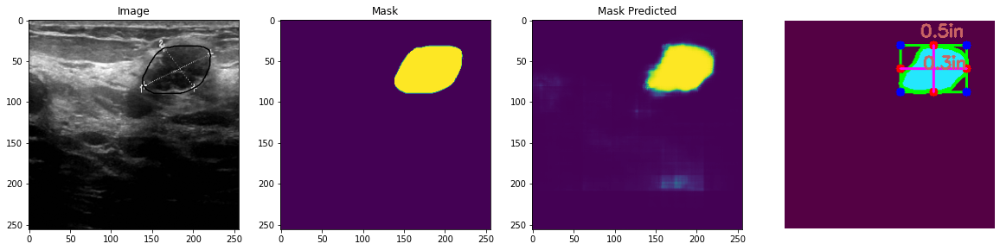

test image: 7
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.24847412109375
area ratio of mask predicted by model 5.449380165289256
[[133.  26.]
 [209.  26.]
 [209.  81.]
 [133.  81.]]
dimA 0.3503184713375796
dimB 0.4840764331210191


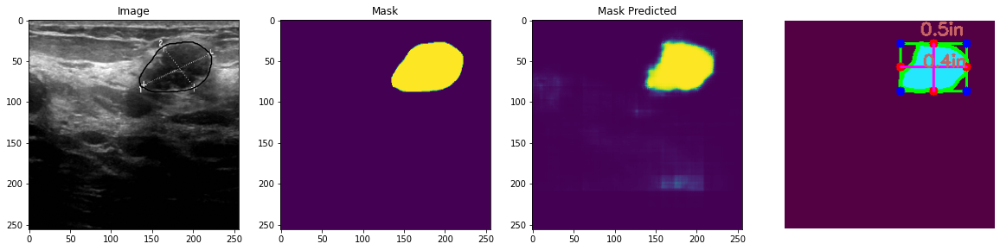

test image: 8
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 9.59014892578125
area ratio of mask predicted by model 100.0
test image: 9
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.4271240234375
area ratio of mask predicted by model 100.0
test image: 10
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 19.17724609375
area ratio of mask predicted by model 12.320936639118457
[[ 78.  71.]
 [155.  46.]
 [194. 168.]
 [116. 192.]]
dimA 0.8118083645812535
dimB 0.5177094199753156


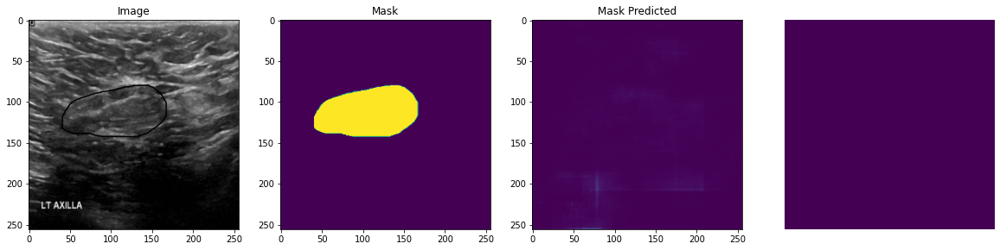

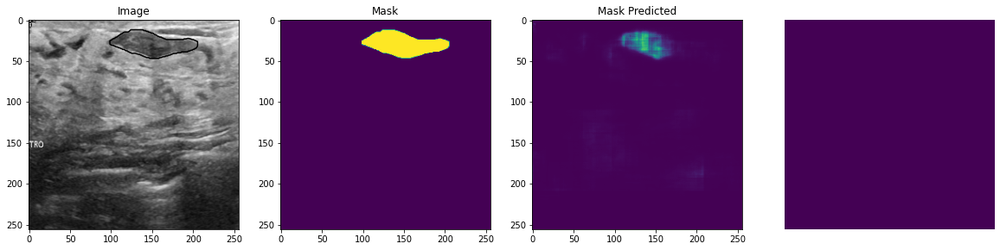

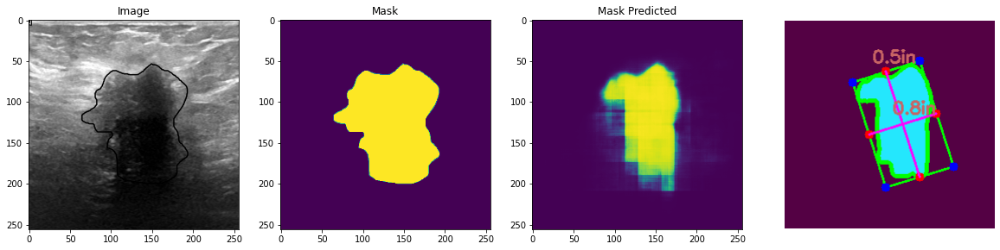

test image: 11
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.19464111328125
area ratio of mask predicted by model 4.077134986225895
[[129.  28.]
 [194.  28.]
 [194.  75.]
 [129.  75.]]
dimA 0.29936305732484075
dimB 0.4140127388535032


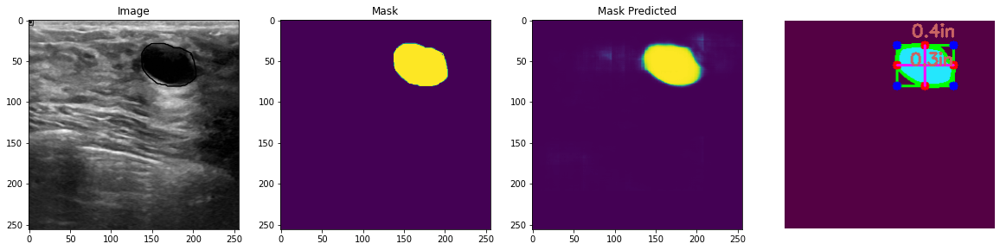

test image: 12
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.6417236328125
area ratio of mask predicted by model 5.389118457300276
[[25. 57.]
 [68. 57.]
 [68. 80.]
 [25. 80.]]
dimA 0.1464968152866242
dimB 0.27388535031847133


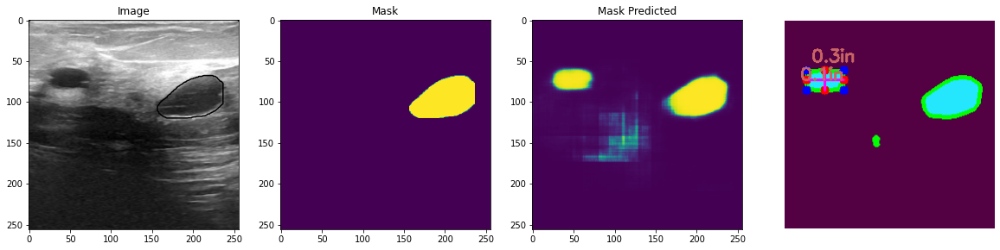

test image: 13
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.88043212890625
area ratio of mask predicted by model 0.02066115702479339
test image: 14
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 20.30029296875
area ratio of mask predicted by model 25.974517906336086
[[  2.  10.]
 [212.   8.]
 [213. 102.]
 [  3. 104.]]
dimA 0.5987599936206889
dimB 1.3376402776660778


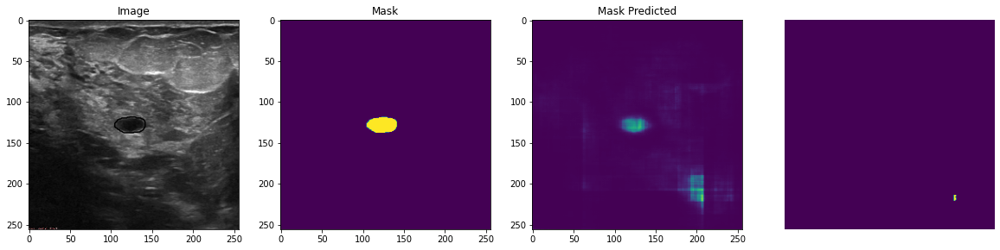

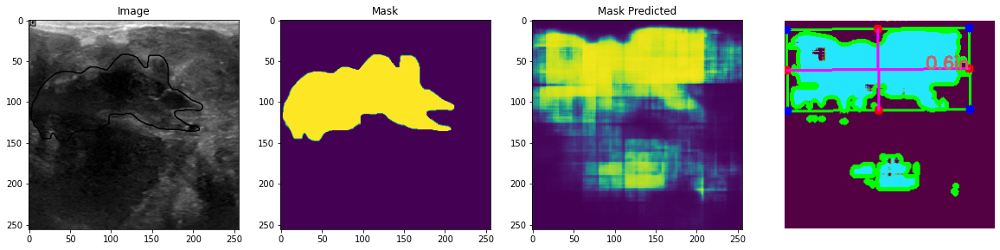

test image: 15
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 37.04376220703125
area ratio of mask predicted by model 24.264807162534435
[[ 81. -12.]
 [235.  89.]
 [154. 212.]
 [  0. 110.]]
dimA 0.93540079324415
dimB 1.1747794252711818


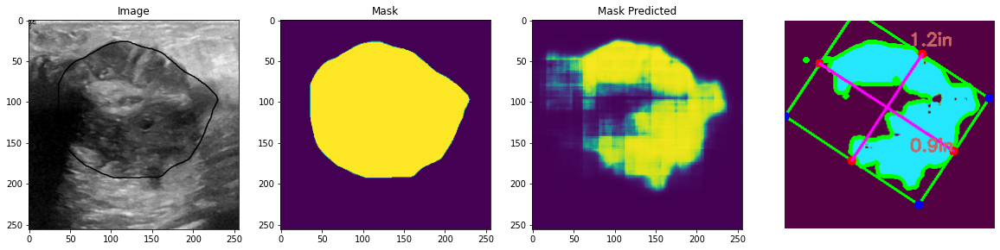

test image: 16
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.72314453125
area ratio of mask predicted by model 0.3581267217630854
test image: 17
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.32183837890625
area ratio of mask predicted by model 2.9201101928374653
[[176.  46.]
 [222.  55.]
 [213. 102.]
 [167.  93.]]
dimA 0.30480219398739866
dimB 0.2985488317263176


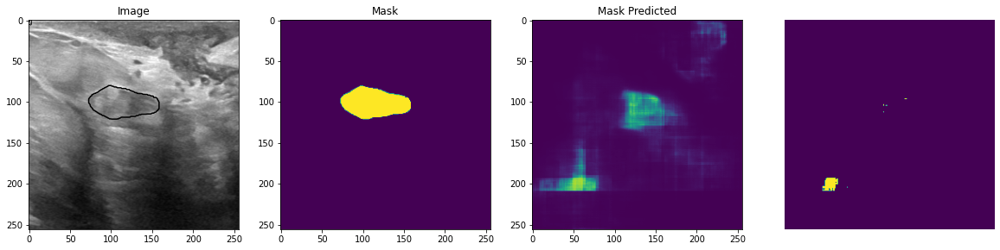

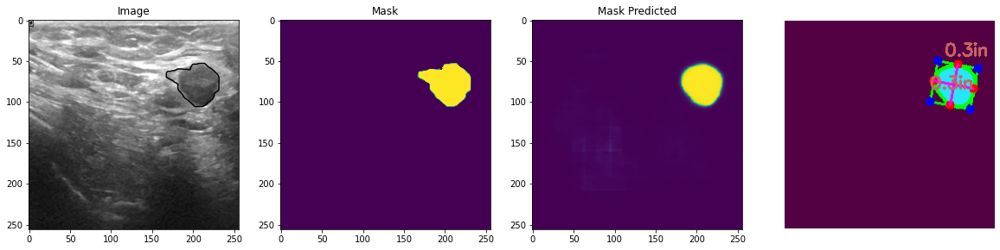

test image: 18
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.070068359375
area ratio of mask predicted by model 2.9545454545454546
[[ 91.  24.]
 [153.  24.]
 [153.  60.]
 [ 91.  60.]]
dimA 0.22929936305732485
dimB 0.39490445859872614


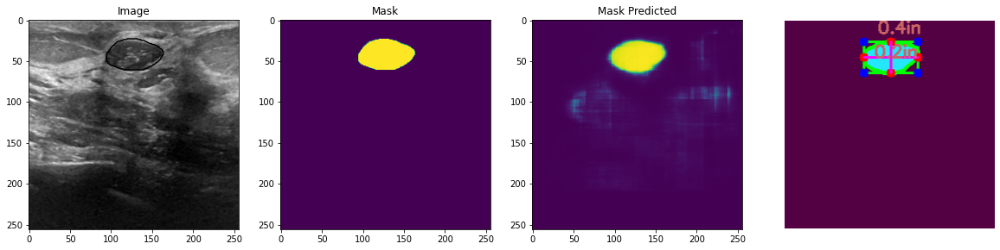

test image: 19
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.61749267578125
area ratio of mask predicted by model 10.752410468319558
[[ 62.  13.]
 [202.  40.]
 [190. 102.]
 [ 50.  75.]]
dimA 0.40223320774132343
dimB 0.9081516064723723


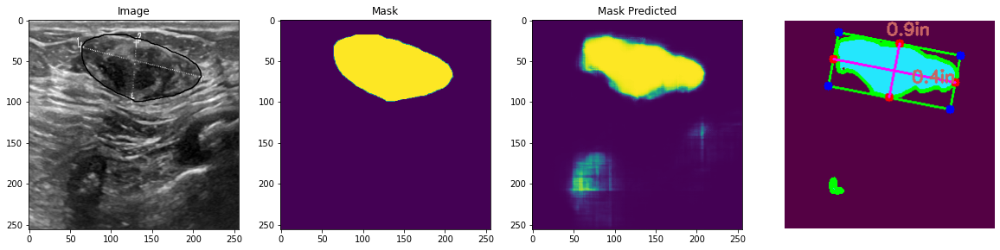

test image: 20
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.2877197265625
area ratio of mask predicted by model 100.0
test image: 21
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.4752197265625
area ratio of mask predicted by model 16.210399449035812
[[ 67.  76.]
 [212.  49.]
 [229. 137.]
 [ 84. 164.]]
dimA 0.570872642414183
dimB 0.9394418642302506


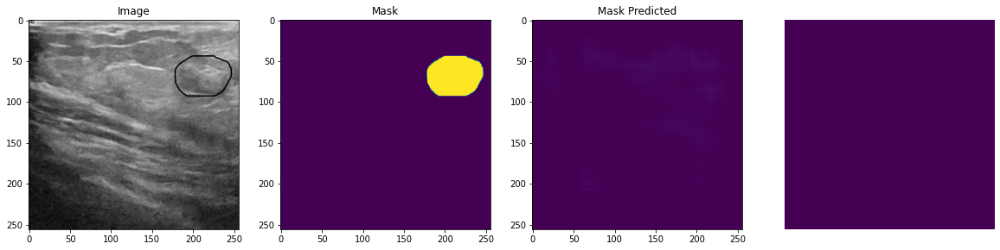

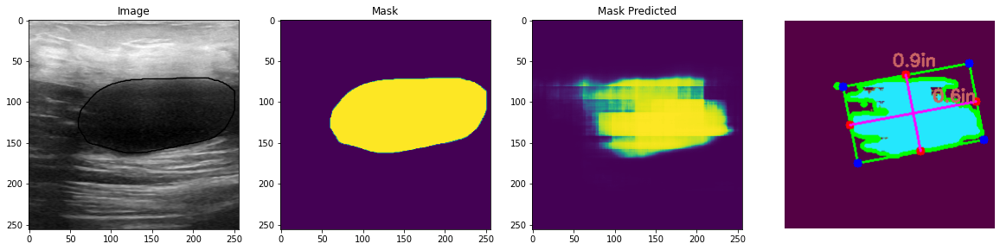

test image: 22
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.2816162109375
area ratio of mask predicted by model 5.146349862258953
[[ 67.  36.]
 [128.  36.]
 [128.  89.]
 [ 67.  89.]]
dimA 0.3375796178343949
dimB 0.3885350318471338


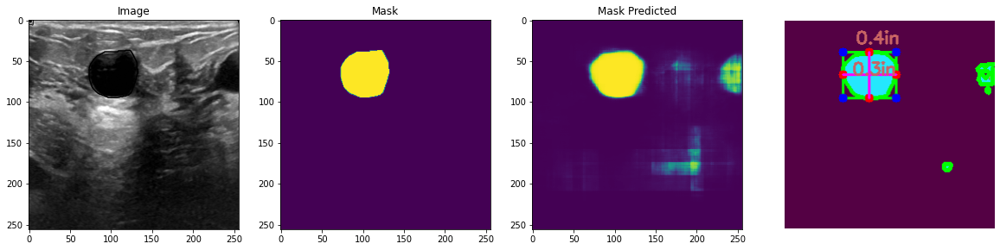

test image: 23
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.421630859375
area ratio of mask predicted by model 10.922865013774105
[[ 99.  24.]
 [203.  71.]
 [169. 145.]
 [ 65.  98.]]
dimA 0.5187075941784034
dimB 0.7269243446186833


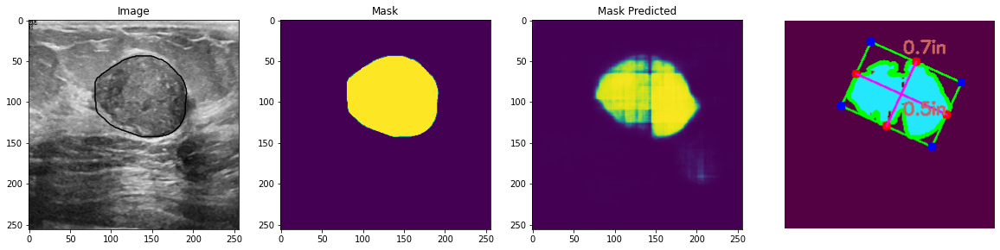

test image: 24
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.2398681640625
area ratio of mask predicted by model 4.958677685950414
[[ 84.  47.]
 [149.  47.]
 [149. 103.]
 [ 84. 103.]]
dimA 0.35668789808917195
dimB 0.4140127388535032


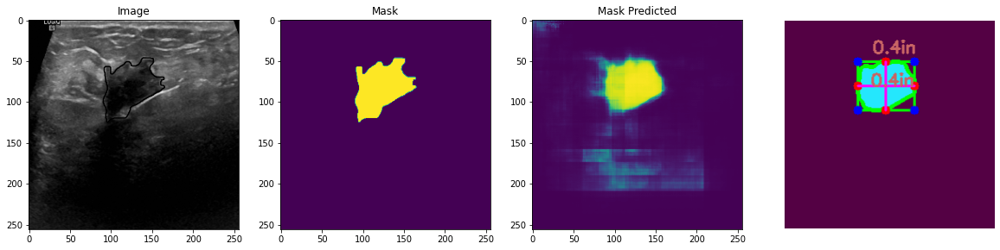

test image: 25
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.4852294921875
area ratio of mask predicted by model 0.4941460055096419
test image: 26
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.88433837890625
area ratio of mask predicted by model 1.2017906336088153
[[150. 164.]
 [197. 164.]
 [197. 179.]
 [150. 179.]]
dimA 0.09554140127388536
dimB 0.29936305732484075


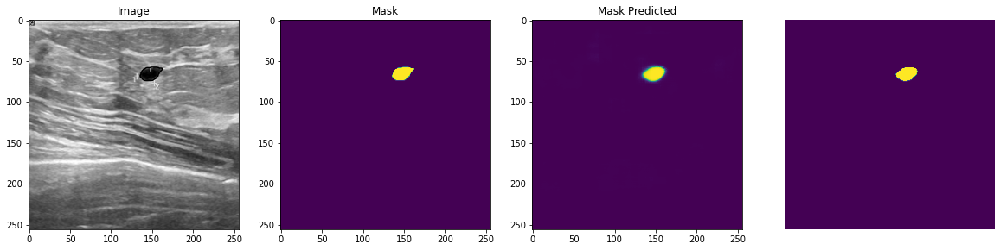

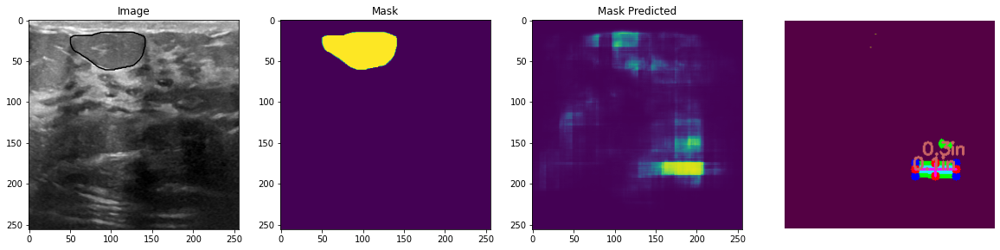

test image: 27
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.69598388671875
area ratio of mask predicted by model 7.5688705234159785
[[ 86.  10.]
 [209.  18.]
 [206.  65.]
 [ 83.  57.]]
dimA 0.2999722761609329
dimB 0.7850948282897284


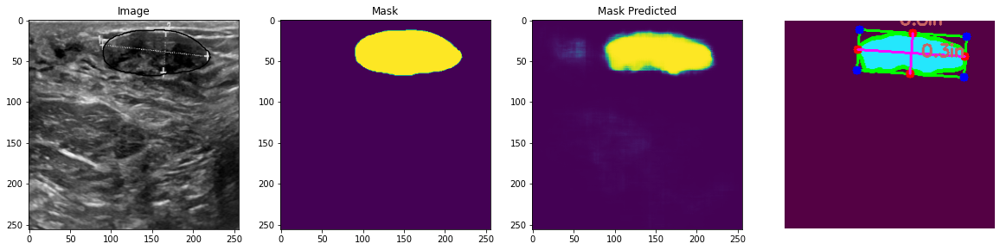

test image: 28
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.45843505859375
area ratio of mask predicted by model 8.863636363636363
[[-1. 21.]
 [12.  5.]
 [25. 17.]
 [11. 33.]]
dimA 0.11036766529403476
dimB 0.13334026379272815


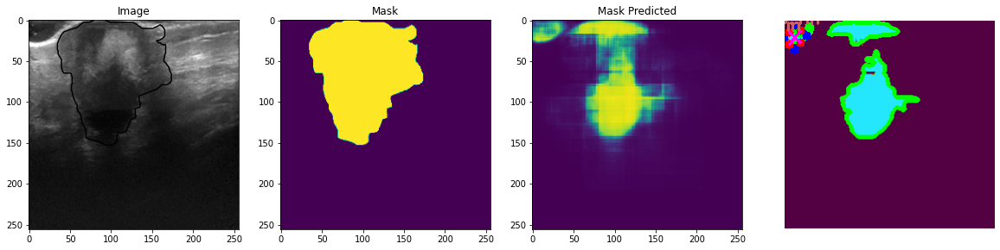

test image: 29
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.80596923828125
area ratio of mask predicted by model 4.839876033057852
[[162.  32.]
 [242.  38.]
 [239.  83.]
 [158.  76.]]
dimA 0.28431482956261966
dimB 0.5144076179170465


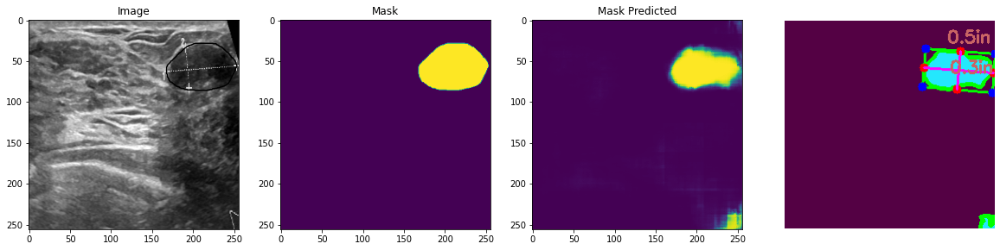

test image: 30
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.02459716796875
area ratio of mask predicted by model 16.62362258953168
[[ 37.  86.]
 [ 60.  84.]
 [ 62. 105.]
 [ 39. 107.]]
dimA 0.1343632045205668
dimB 0.14704963542184962


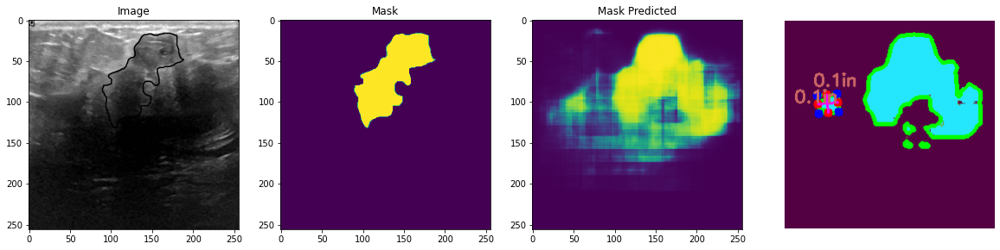

test image: 31
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.3101806640625
area ratio of mask predicted by model 2.2331267217630852
[[ 81.  77.]
 [128.  63.]
 [138.  95.]
 [ 91. 109.]]
dimA 0.21354209699669058
dimB 0.3123617792417638


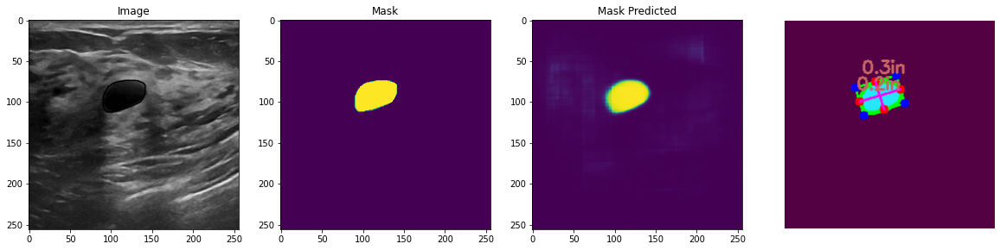

test image: 32
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.001953125
area ratio of mask predicted by model 1.802685950413223
[[130.  68.]
 [175.  60.]
 [180.  89.]
 [136.  98.]]
dimA 0.19113587373405933
dimB 0.2885638545241858


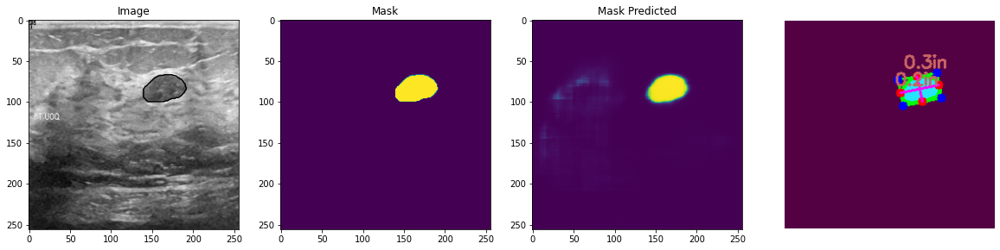

test image: 33
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.87481689453125
area ratio of mask predicted by model 26.616735537190085
[[ 59.  23.]
 [219.  -7.]
 [248. 141.]
 [ 88. 172.]]
dimA 0.9637271033931738
dimB 1.0374591821498147


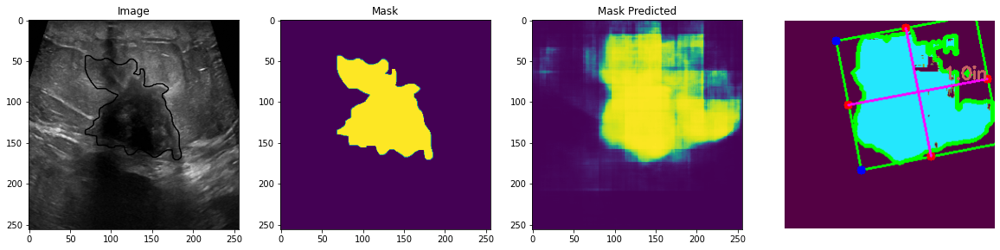

test image: 34
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.78472900390625
area ratio of mask predicted by model 0.14807162534435261
test image: 35
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.9571533203125
area ratio of mask predicted by model 3.1904269972451793
[[135.  53.]
 [180.  44.]
 [190.  92.]
 [145. 101.]]
dimA 0.3122968324109876
dimB 0.292300481670924


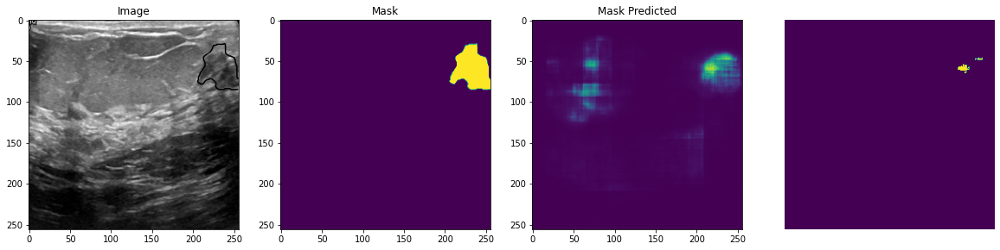

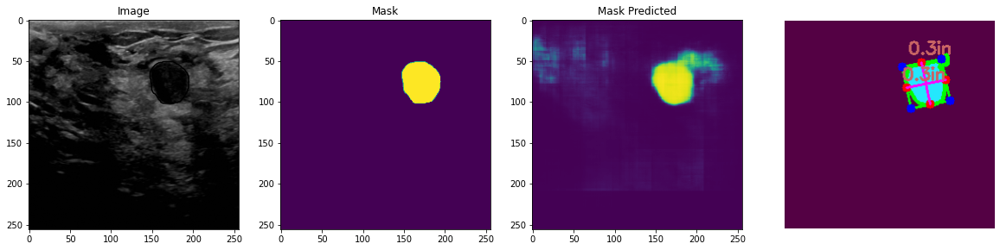

test image: 36
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.51702880859375
area ratio of mask predicted by model 3.0079201101928374
[[ 45.  30.]
 [ 96.  19.]
 [105.  56.]
 [ 53.  68.]]
dimA 0.24491253413669273
dimB 0.33610421486079367


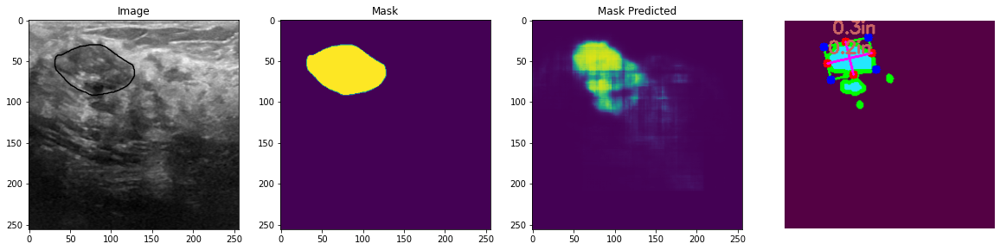

test image: 37
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.0364990234375
area ratio of mask predicted by model 1.756198347107438
[[169.  48.]
 [199.  49.]
 [197.  89.]
 [167.  88.]]
dimA 0.2550953426051056
dimB 0.19118893018858132


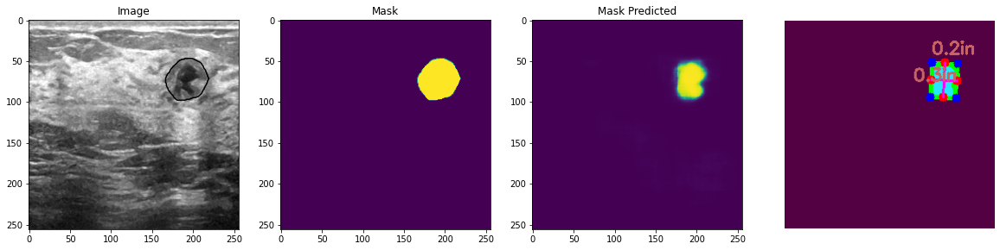

test image: 38
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 16.38946533203125
area ratio of mask predicted by model 16.268939393939394
[[ 68.  36.]
 [217.  36.]
 [217. 119.]
 [ 68. 119.]]
dimA 0.5286624203821656
dimB 0.9490445859872612


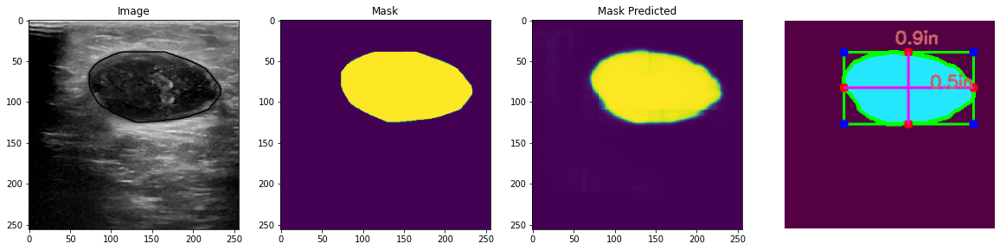

test image: 39
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 9.1461181640625
area ratio of mask predicted by model 7.858126721763085
[[ 89.   9.]
 [208.  17.]
 [204.  65.]
 [ 86.  57.]]
dimA 0.3065441719957488
dimB 0.7564951286764142


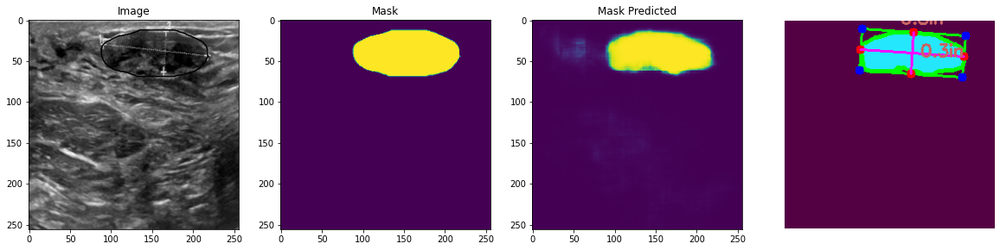

test image: 40
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.64630126953125
area ratio of mask predicted by model 8.944559228650139
[[ 37.  22.]
 [125.  36.]
 [118.  74.]
 [ 31.  59.]]
dimA 0.24241506030554222
dimB 0.5649254251071483


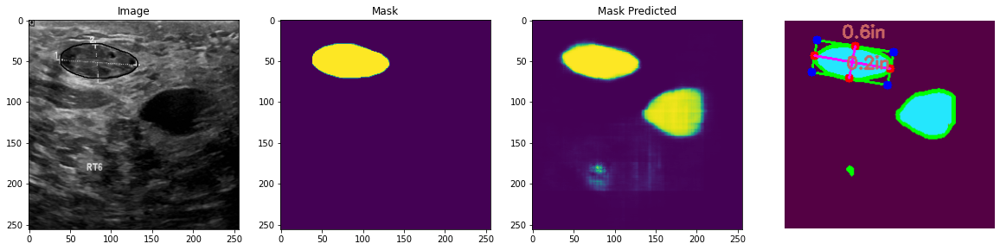

test image: 41
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.90179443359375
area ratio of mask predicted by model 0.724862258953168
test image: 42
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.85455322265625
area ratio of mask predicted by model 10.158402203856749
[[ 43.  79.]
 [112.  28.]
 [174. 112.]
 [105. 163.]]
dimA 0.6649876757267866
dimB 0.5465101775570098


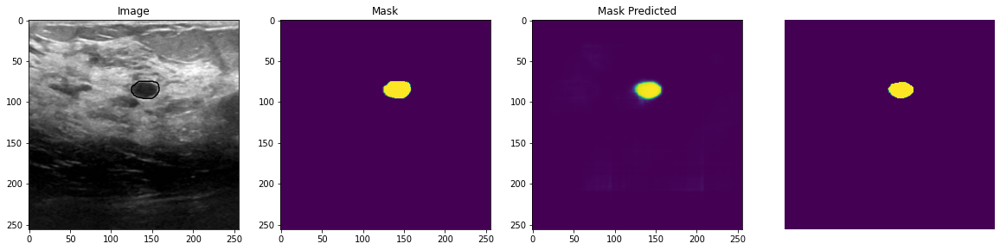

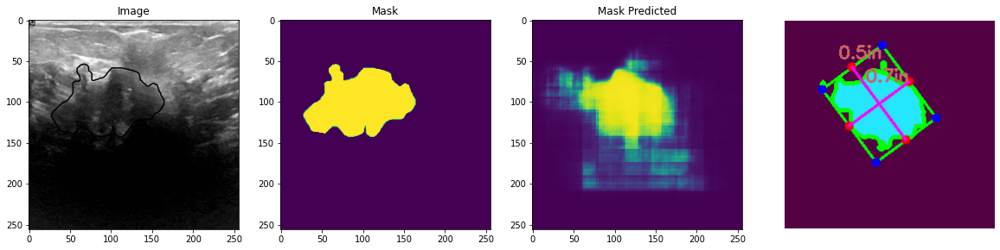

test image: 43
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.49993896484375
area ratio of mask predicted by model 1.4084022038567492
[[119.  44.]
 [148.  44.]
 [148.  78.]
 [119.  78.]]
dimA 0.21656050955414013
dimB 0.18471337579617833


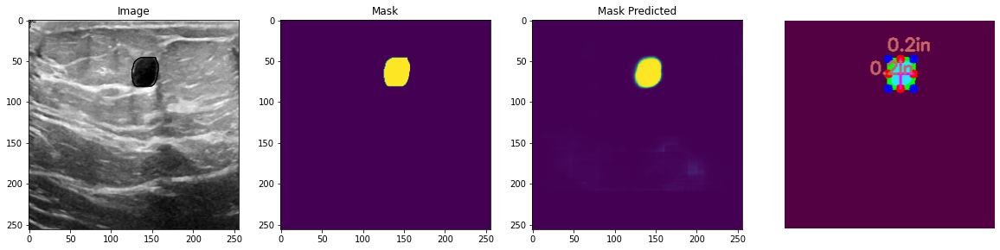

test image: 44
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 10.693359375
area ratio of mask predicted by model 17.405303030303028
[[ 52. 100.]
 [124. 133.]
 [ 89. 209.]
 [ 17. 176.]]
dimA 0.5329425387454509
dimB 0.504473074488309


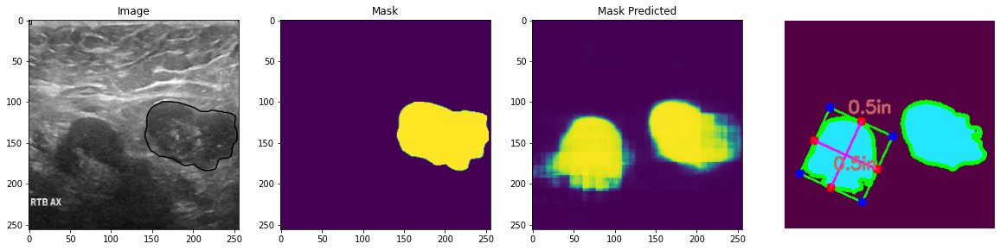

test image: 45
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.34259033203125
area ratio of mask predicted by model 15.699035812672177
[[ 38. 109.]
 [195. 130.]
 [184. 214.]
 [ 27. 194.]]
dimA 0.5427577611247457
dimB 1.0084886579430252


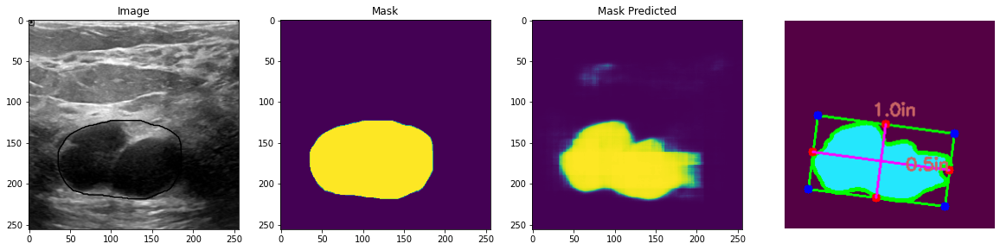

test image: 46
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.58050537109375
area ratio of mask predicted by model 1.6993801652892562
[[134.  28.]
 [164.  38.]
 [151.  76.]
 [121.  65.]]
dimA 0.2527988486938361
dimB 0.2024485996855136


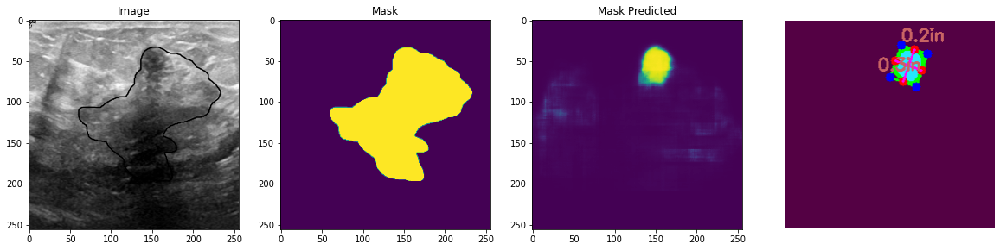

test image: 47
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.74407958984375
area ratio of mask predicted by model 4.390495867768595
[[115.  38.]
 [145.  57.]
 [138.  70.]
 [107.  51.]]
dimA 0.09559446509429066
dimB 0.22887877208701848


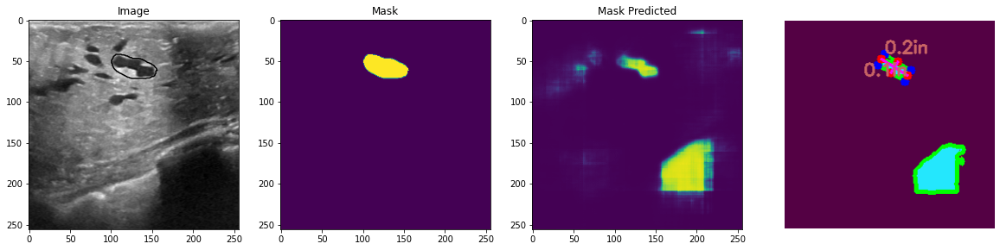

test image: 48
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.35498046875
area ratio of mask predicted by model 1.2517217630853994
[[106.  48.]
 [138.  29.]
 [151.  51.]
 [120.  70.]]
dimA 0.16440649043490838
dimB 0.23430921308173772


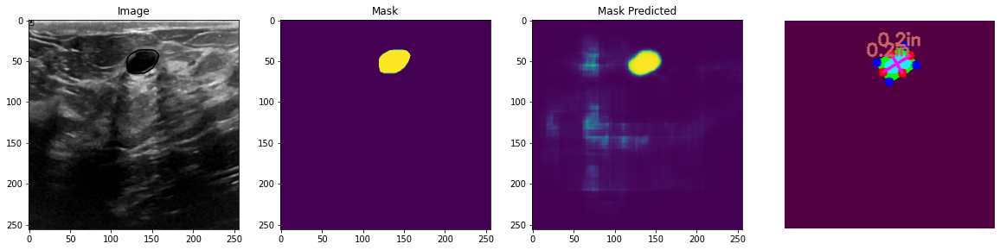

test image: 49
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.31756591796875
area ratio of mask predicted by model 100.0
test image: 50
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 31.0638427734375
area ratio of mask predicted by model 20.409779614325068
[[ 78.  13.]
 [225.  13.]
 [225. 134.]
 [ 78. 134.]]
dimA 0.7707006369426752
dimB 0.9363057324840764


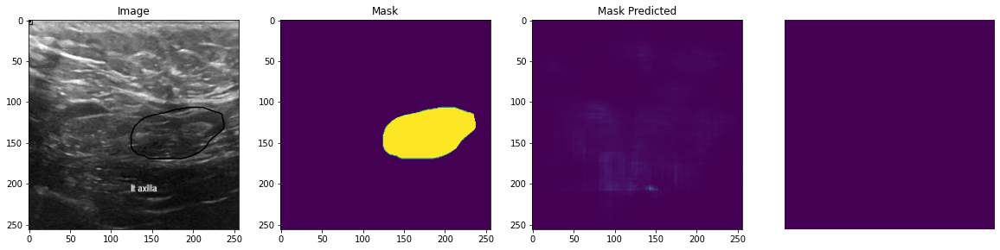

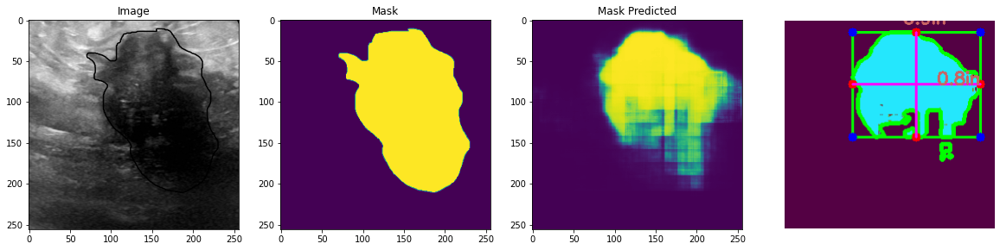

test image: 51
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.97698974609375
area ratio of mask predicted by model 2.694559228650138
[[104.  32.]
 [161.  32.]
 [161.  70.]
 [104.  70.]]
dimA 0.24203821656050956
dimB 0.3630573248407643


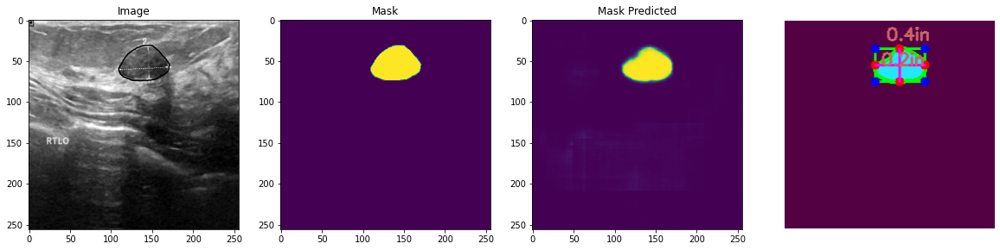

test image: 52
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.79083251953125
area ratio of mask predicted by model 2.190082644628099
[[169.  50.]
 [209.  50.]
 [209.  91.]
 [169.  91.]]
dimA 0.2611464968152866
dimB 0.25477707006369427


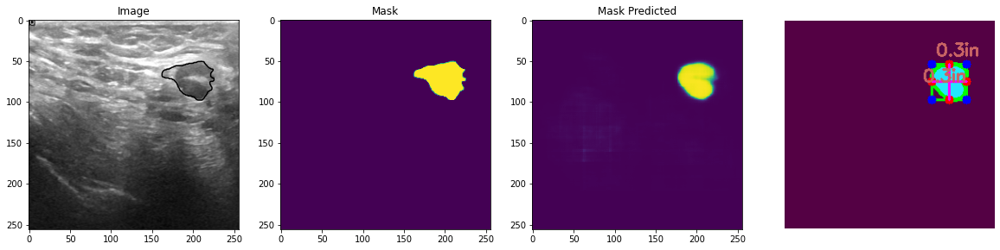

test image: 53
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.63427734375
area ratio of mask predicted by model 31.630509641873278
[[ 13. 106.]
 [ 30. 106.]
 [ 30. 120.]
 [ 13. 120.]]
dimA 0.08917197452229299
dimB 0.10828025477707007


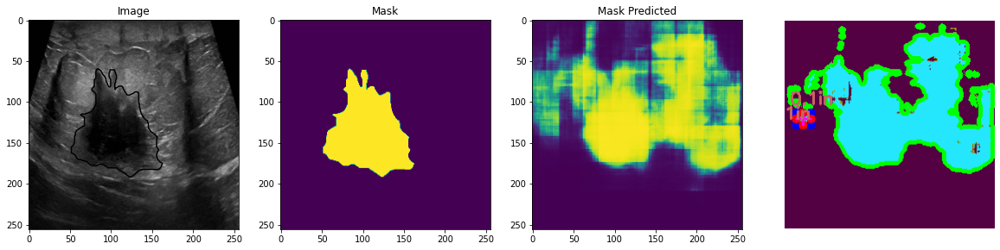

test image: 54
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.9337158203125
area ratio of mask predicted by model 4.1236225895316805
[[129.  28.]
 [194.  28.]
 [194.  75.]
 [129.  75.]]
dimA 0.29936305732484075
dimB 0.4140127388535032


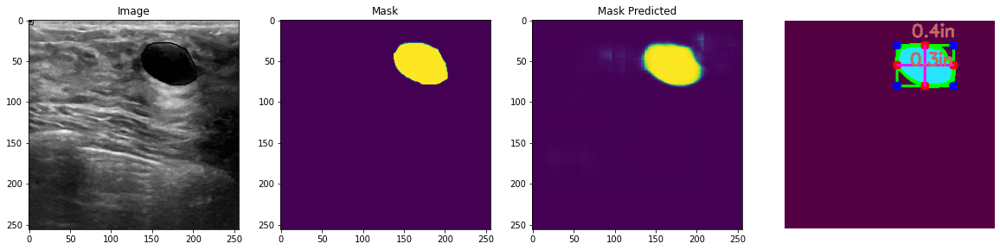

test image: 55
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.34429931640625
area ratio of mask predicted by model 1.3963498622589532
[[ 62.  67.]
 [101.  67.]
 [101.  93.]
 [ 62.  93.]]
dimA 0.16560509554140126
dimB 0.2484076433121019


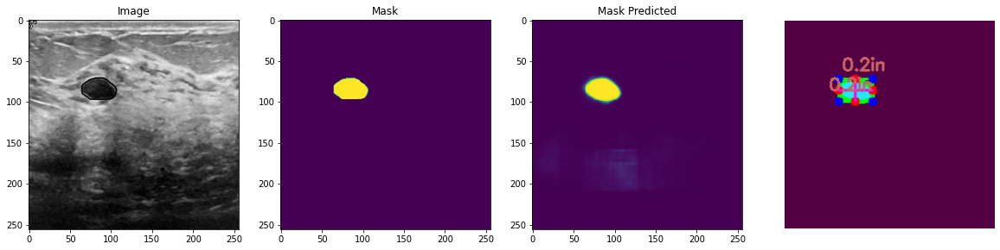

test image: 56
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.5552978515625
area ratio of mask predicted by model 3.2110881542699725
[[ 50. 116.]
 [110. 111.]
 [114. 150.]
 [ 54. 156.]]
dimA 0.2528790768293671
dimB 0.38376787258920503


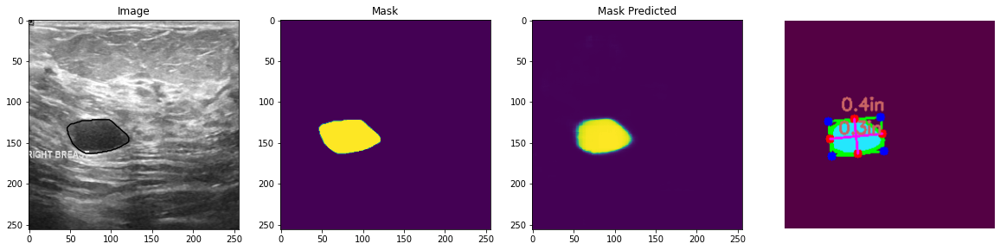

test image: 57
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.94451904296875
area ratio of mask predicted by model 100.0
test image: 58
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 15.6219482421875
area ratio of mask predicted by model 13.830922865013772
[[ 78.  25.]
 [196.  31.]
 [191. 122.]
 [ 73. 116.]]
dimA 0.5804920963090164
dimB 0.7525633369550028


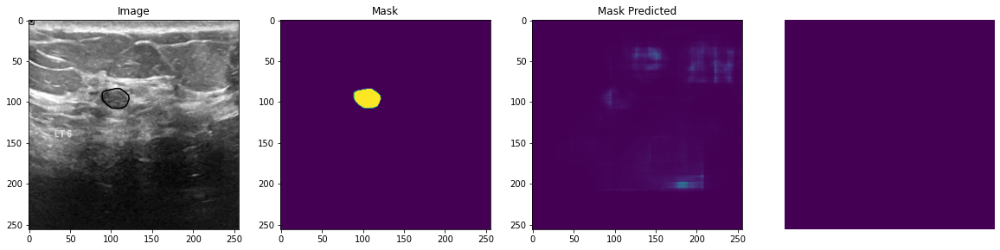

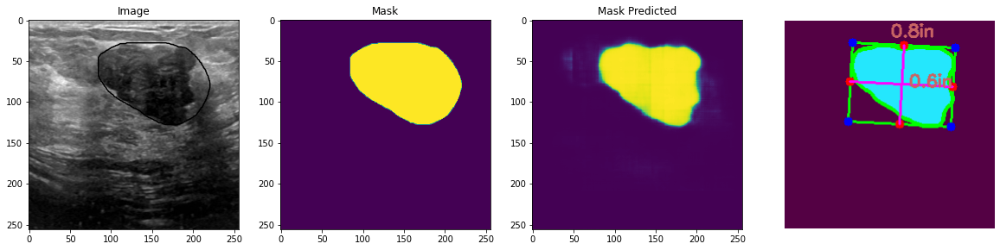

test image: 59
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.06146240234375
area ratio of mask predicted by model 2.021349862258953
[[117.  54.]
 [157.  22.]
 [177.  48.]
 [137.  80.]]
dimA 0.20893273206186913
dimB 0.3262738464933936


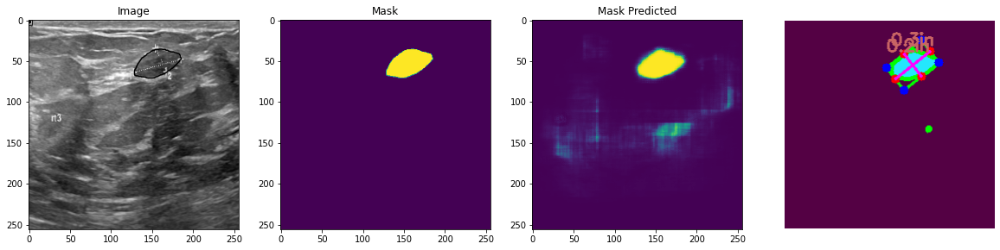

test image: 60
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 23.541259765625
area ratio of mask predicted by model 19.18904958677686
[[134.  -4.]
 [227.  96.]
 [143. 173.]
 [ 50.  73.]]
dimA 0.7258072877241907
dimB 0.8698174619634845


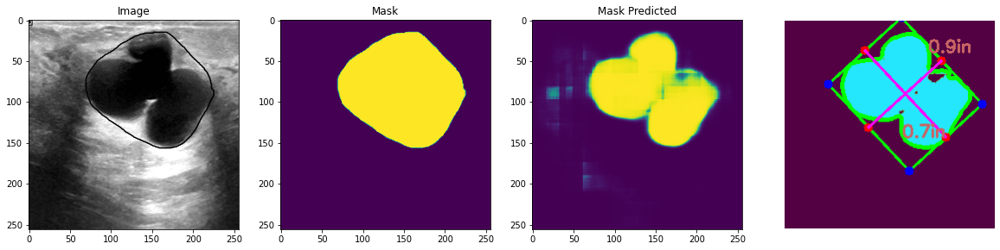

test image: 61
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.61895751953125
area ratio of mask predicted by model 4.557506887052341
[[ 78.  53.]
 [100.  35.]
 [120.  58.]
 [ 97.  77.]]
dimA 0.19450231190576395
dimB 0.1855351804284014


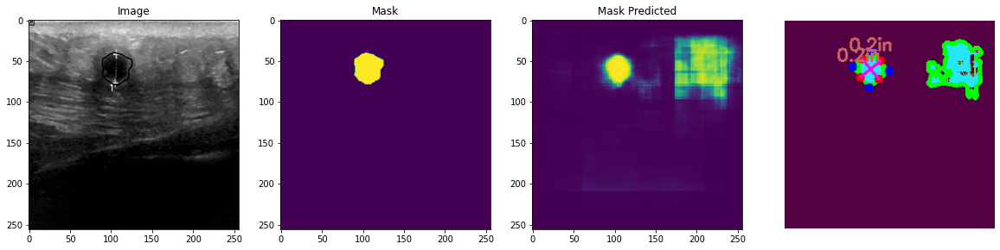

test image: 62
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.287353515625
area ratio of mask predicted by model 13.231749311294767
[[  3. 125.]
 [ 88.  55.]
 [142. 120.]
 [ 57. 191.]]
dimA 0.5406983072085874
dimB 0.703389209164564


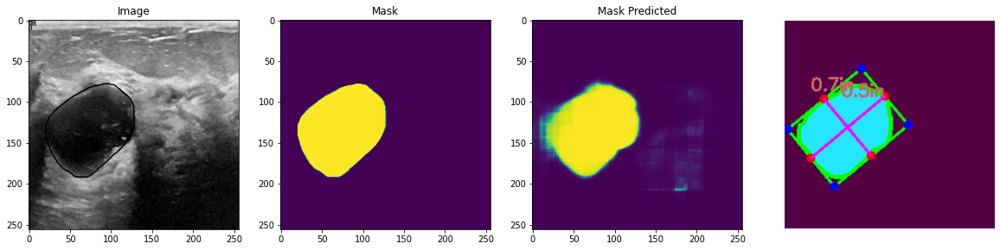

test image: 63
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.7822265625
area ratio of mask predicted by model 100.0
test image: 64
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.11236572265625
area ratio of mask predicted by model 1.5771349862258952
[[ 78.  63.]
 [107.  88.]
 [ 93. 104.]
 [ 65.  78.]]
dimA 0.13092232351015584
dimB 0.24358373472576997


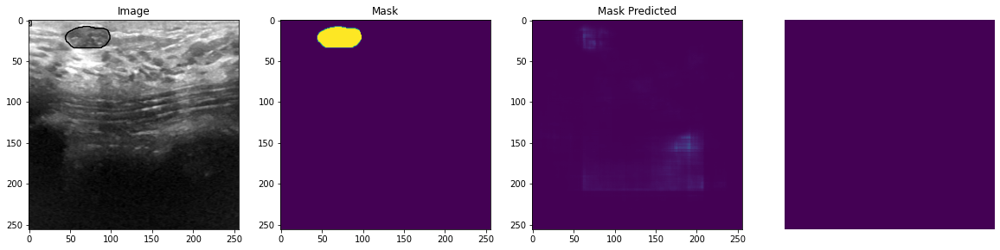

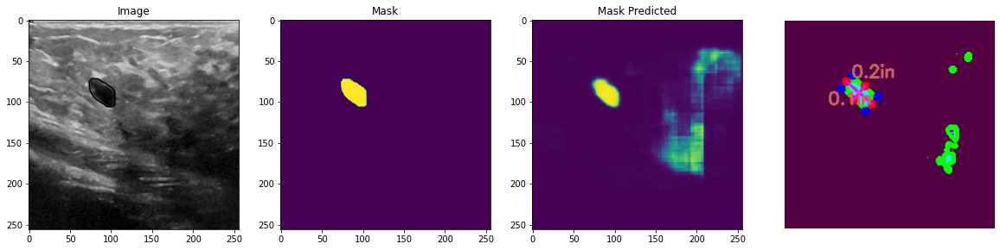

test image: 65
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.998779296875
area ratio of mask predicted by model 4.8829201101928374
[[ 65.  36.]
 [109.  -2.]
 [152.  45.]
 [108.  84.]]
dimA 0.4081033431313654
dimB 0.37239364312127754


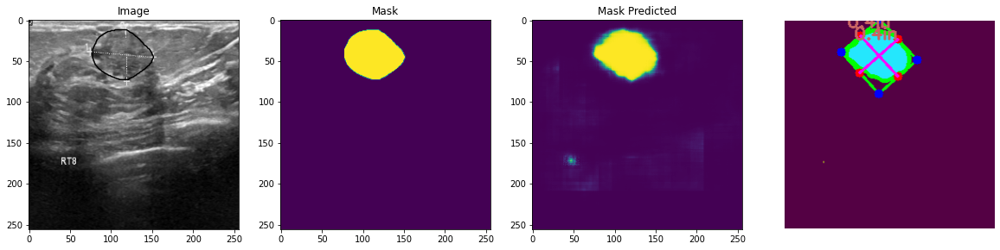

test image: 66
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 15.79132080078125
area ratio of mask predicted by model 0.7369146005509642
test image: 67
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 16.4520263671875
area ratio of mask predicted by model 15.773071625344354
[[ 29.  10.]
 [207.  72.]
 [180. 148.]
 [  2.  86.]]
dimA 0.5137170713739927
dimB 1.2005651366454433


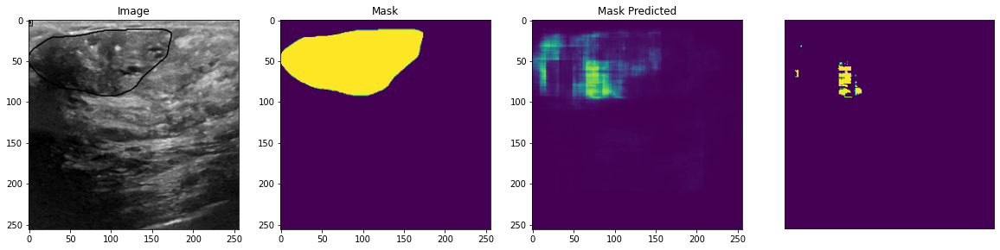

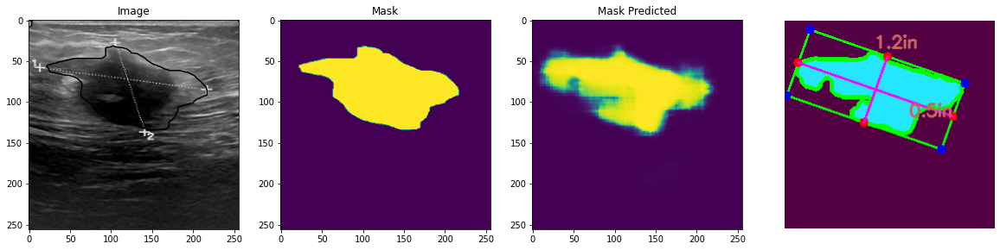

test image: 68
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.64739990234375
area ratio of mask predicted by model 2.1349862258953167
[[31. 53.]
 [88. 37.]
 [95. 63.]
 [38. 79.]]
dimA 0.171502063921481
dimB 0.3770894296972149


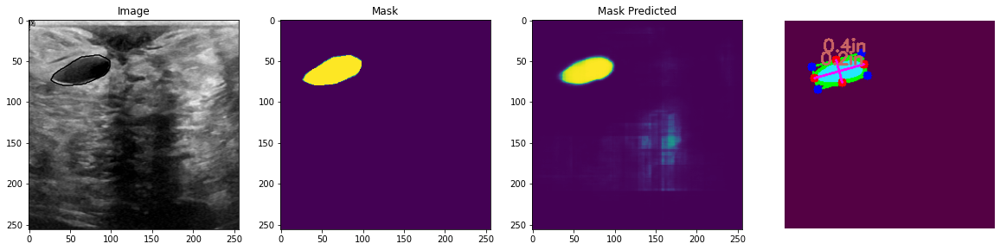

test image: 69
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.08001708984375
area ratio of mask predicted by model 8.548553719008265
[[ 63.  62.]
 [131.  48.]
 [151. 141.]
 [ 84. 156.]]
dimA 0.6096875706712308
dimB 0.43974422655266443


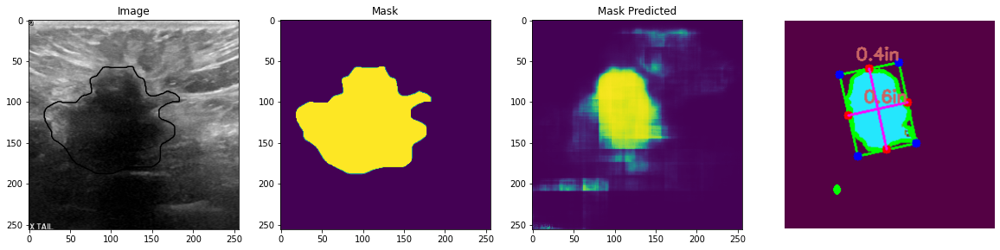

test image: 70
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.59967041015625
area ratio of mask predicted by model 100.0
test image: 71
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.17938232421875
area ratio of mask predicted by model 4.018595041322314
[[129.  28.]
 [193.  28.]
 [193.  75.]
 [129.  75.]]
dimA 0.29936305732484075
dimB 0.40764331210191085


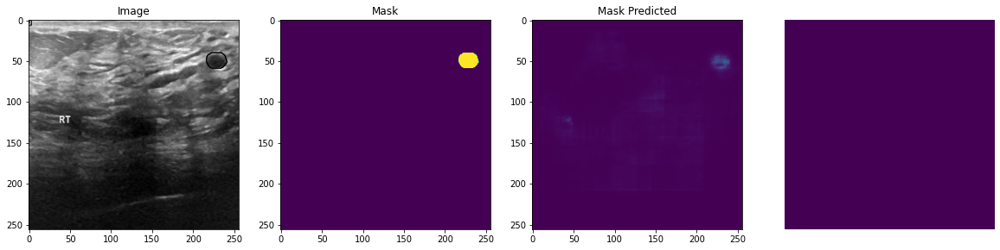

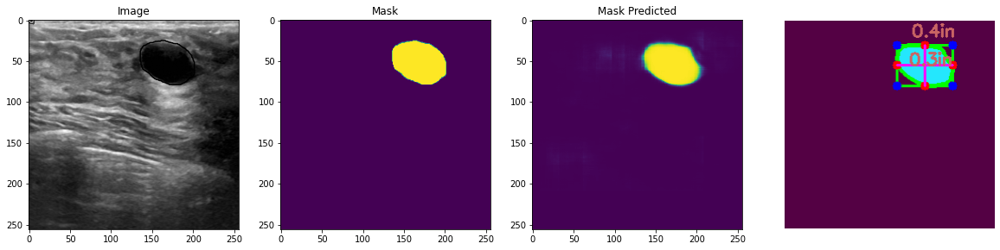

test image: 72
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.232666015625
area ratio of mask predicted by model 8.224862258953168
[[ 34.  77.]
 [ 60.  77.]
 [ 60. 106.]
 [ 34. 106.]]
dimA 0.18471337579617833
dimB 0.16560509554140126


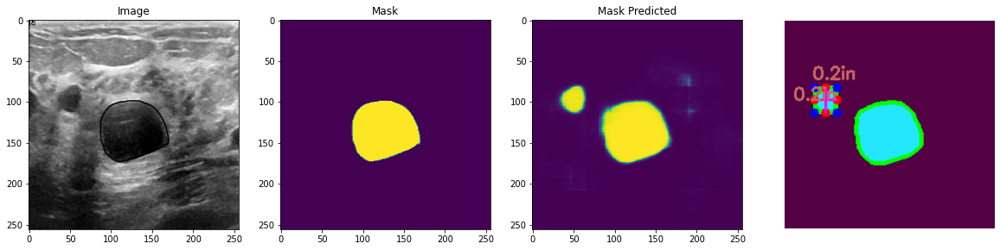

test image: 73
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.0965576171875
area ratio of mask predicted by model 7.191804407713498
[[ 37. 134.]
 [ 58. 133.]
 [ 60. 164.]
 [ 39. 166.]]
dimA 0.20104094397562586
dimB 0.13409874695176624


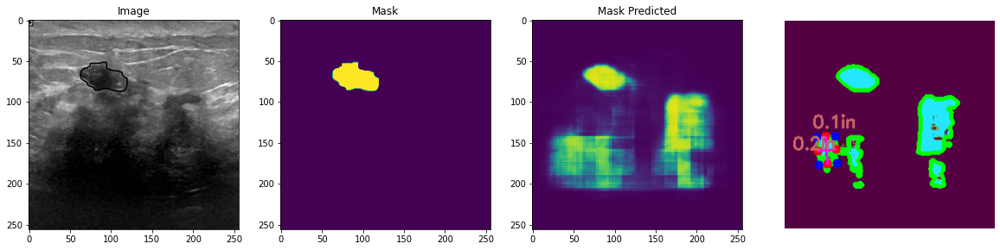

test image: 74
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.567626953125
area ratio of mask predicted by model 0.962465564738292
test image: 75
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.78167724609375
area ratio of mask predicted by model 0.027548209366391182
test image: 76
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 36.590576171875
area ratio of mask predicted by model 10.074035812672175
[[ 77.  22.]
 [196.  38.]
 [185. 120.]
 [ 66. 104.]]
dimA 0.5269714341878485
dimB 0.7647822448407203


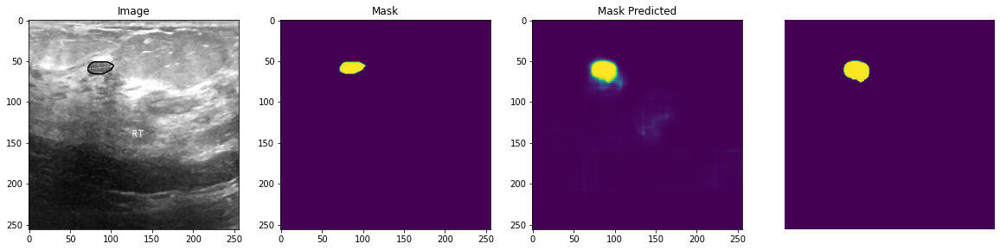

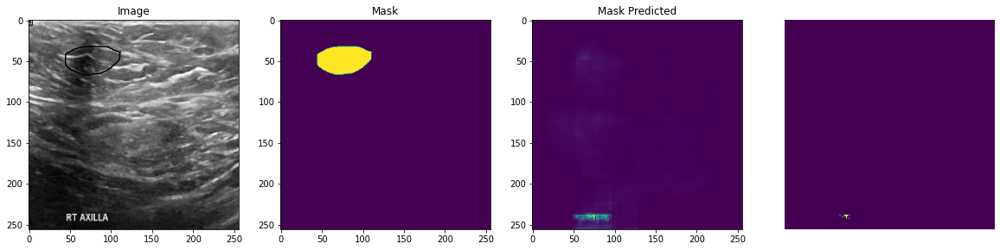

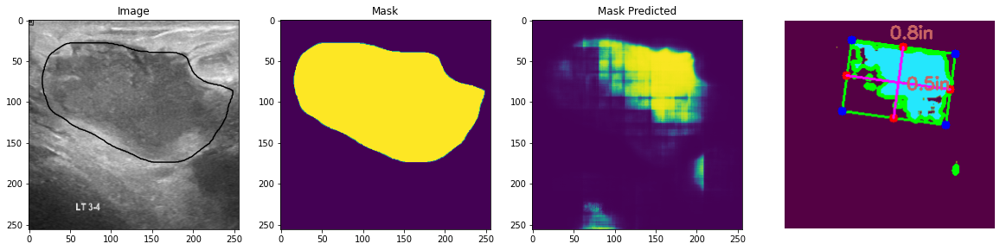

test image: 77
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.9552001953125
area ratio of mask predicted by model 1.5702479338842976
[[70. 47.]
 [98. 47.]
 [98. 68.]
 [70. 68.]]
dimA 0.1337579617834395
dimB 0.17834394904458598


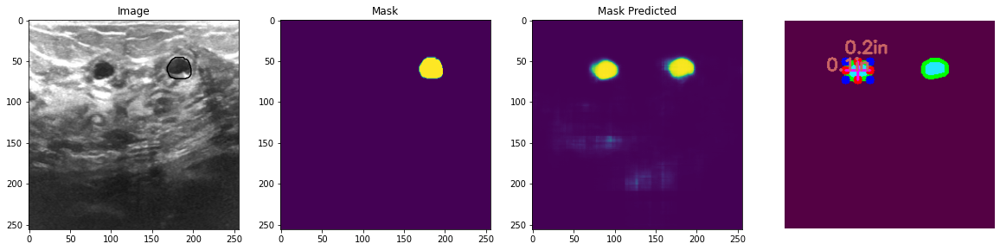

test image: 78
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.946533203125
area ratio of mask predicted by model 14.023760330578513
[[ 88.  13.]
 [204.  52.]
 [175. 137.]
 [ 59.  97.]]
dimA 0.5690308402931732
dimB 0.7805147103752074


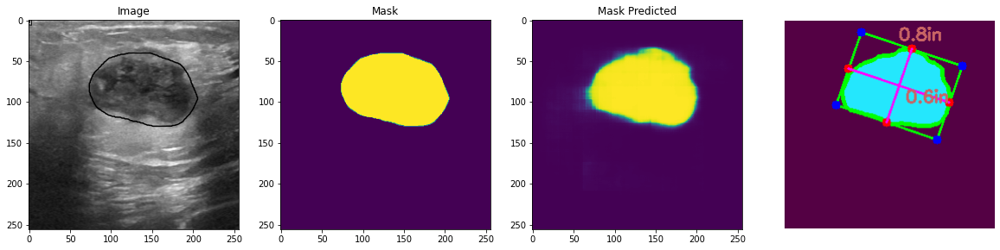

test image: 79
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.983642578125
area ratio of mask predicted by model 1.9645316804407713
[[102.  31.]
 [148.   8.]
 [162.  36.]
 [116.  59.]]
dimA 0.19939459671972648
dimB 0.32757683746812205


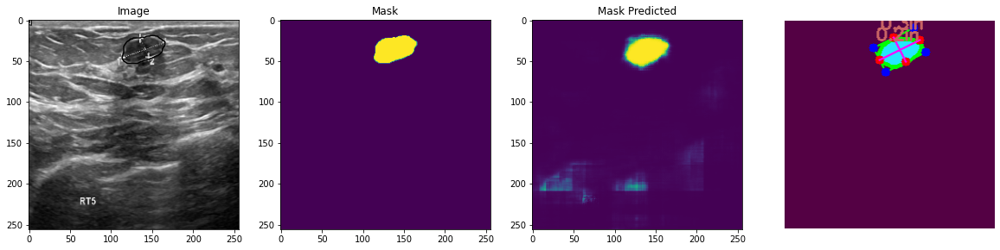

test image: 80
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.6314697265625
area ratio of mask predicted by model 7.627410468319559
[[63. 45.]
 [80. 62.]
 [64. 78.]
 [47. 61.]]
dimA 0.1441236751463027
dimB 0.1531314048429466


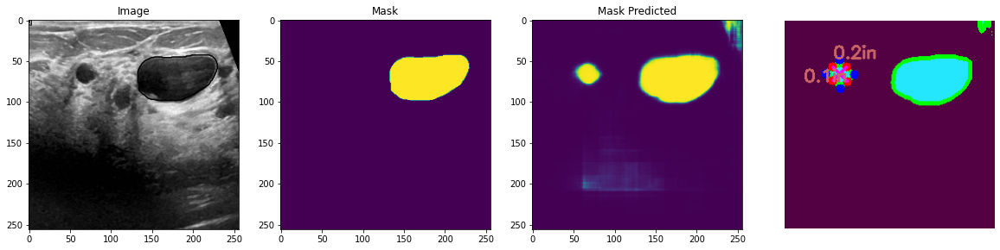

test image: 81
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 23.28338623046875
area ratio of mask predicted by model 16.329201101928376
[[ 33.  73.]
 [192.  65.]
 [197. 157.]
 [ 38. 165.]]
dimA 0.5868520342936285
dimB 1.0140199404410914


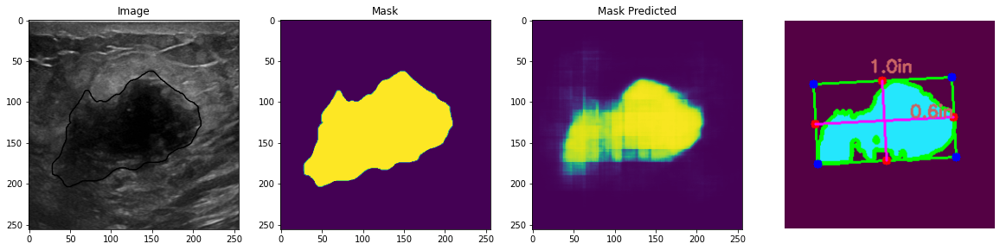

test image: 82
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.57757568359375
area ratio of mask predicted by model 0.14979338842975207
test image: 83
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 37.82196044921875
area ratio of mask predicted by model 34.237258953168045
[[  7.  12.]
 [223.  34.]
 [209. 165.]
 [ -6. 143.]]
dimA 0.8388138444648788
dimB 1.3797455992970828


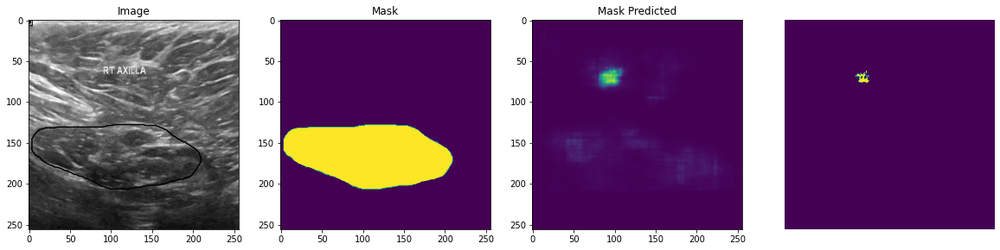

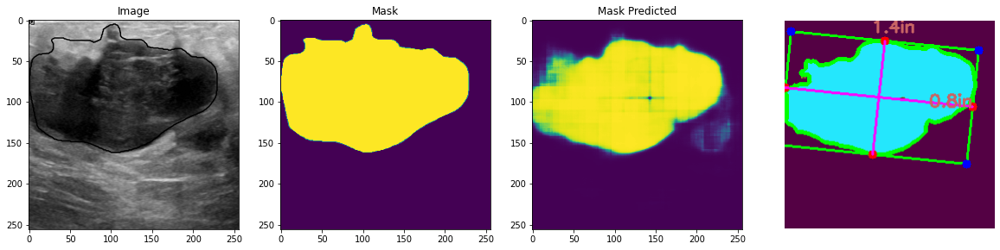

test image: 84
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.034423828125
area ratio of mask predicted by model 1.7458677685950414
[[ 68.  34.]
 [119.  34.]
 [119.  61.]
 [ 68.  61.]]
dimA 0.17197452229299362
dimB 0.3248407643312102


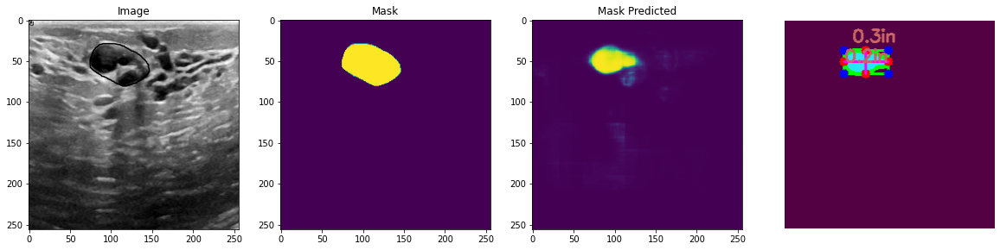

test image: 85
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.95452880859375
area ratio of mask predicted by model 5.12396694214876
[[106.  -3.]
 [154.  44.]
 [113.  85.]
 [ 65.  37.]]
dimA 0.3670718928414147
dimB 0.4301249880854071


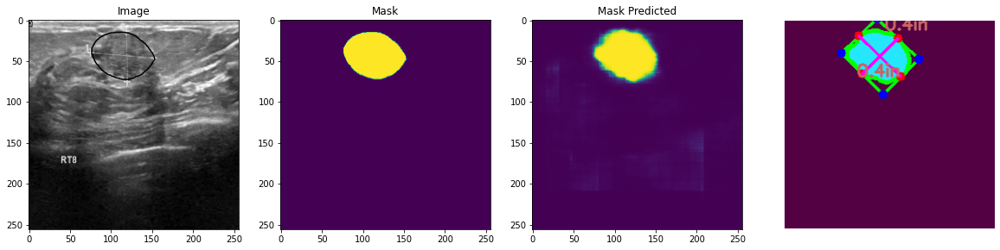

test image: 86
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.9918212890625
area ratio of mask predicted by model 0.9418044077134986
test image: 87
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.168701171875
area ratio of mask predicted by model 3.440082644628099
[[109. 104.]
 [160. 104.]
 [160. 154.]
 [109. 154.]]
dimA 0.3184713375796178
dimB 0.3248407643312102


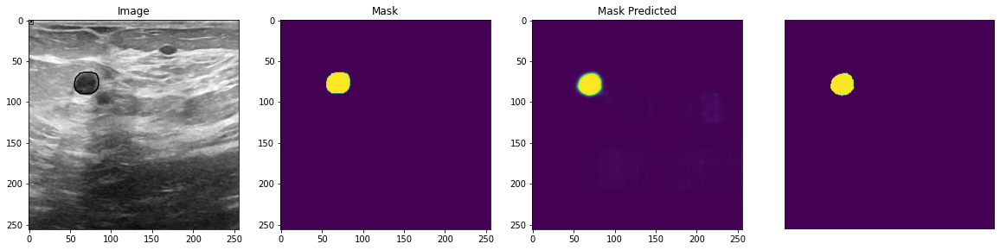

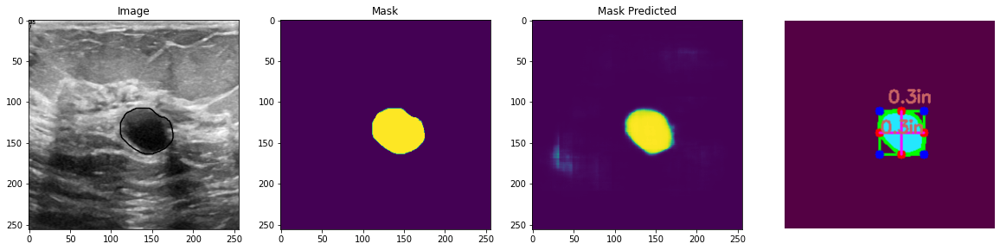

test image: 88
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.34100341796875
area ratio of mask predicted by model 0.0017217630853994489
test image: 89
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.142578125
area ratio of mask predicted by model 18.09573002754821
[[ 75.  12.]
 [183. 102.]
 [107. 194.]
 [  0. 104.]]
dimA 0.7580487559157991
dimB 0.8929984008159205


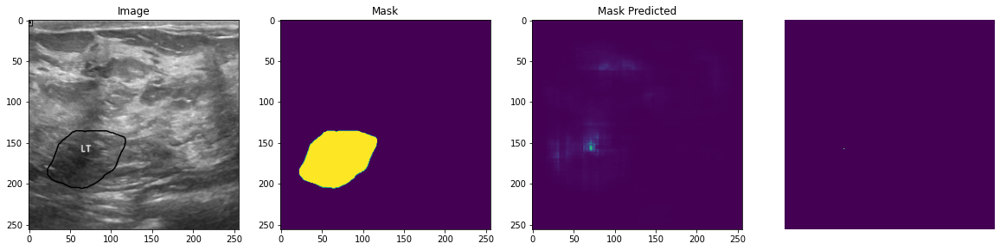

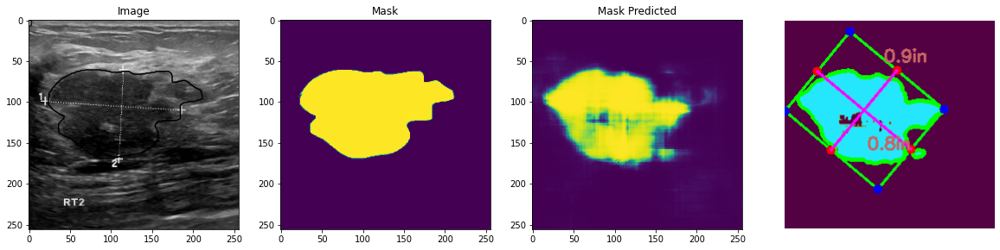

test image: 90
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.42974853515625
area ratio of mask predicted by model 1.3825757575757576
[[ 60.  67.]
 [100.  67.]
 [100.  94.]
 [ 60.  94.]]
dimA 0.17197452229299362
dimB 0.25477707006369427


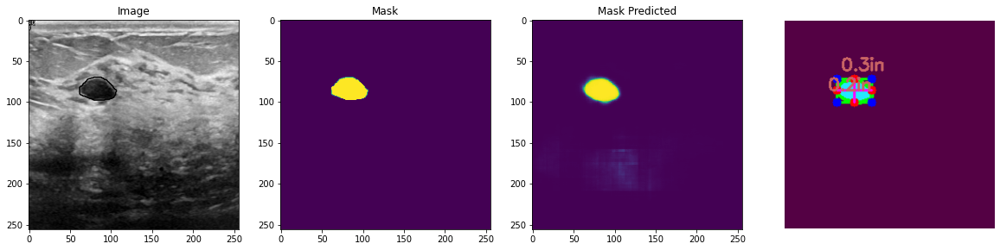

test image: 91
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.51727294921875
area ratio of mask predicted by model 100.0
test image: 92
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.6151123046875
area ratio of mask predicted by model 12.224517906336088
[[  8.  27.]
 [ 85.  27.]
 [ 85. 109.]
 [  8. 109.]]
dimA 0.5222929936305732
dimB 0.49044585987261147


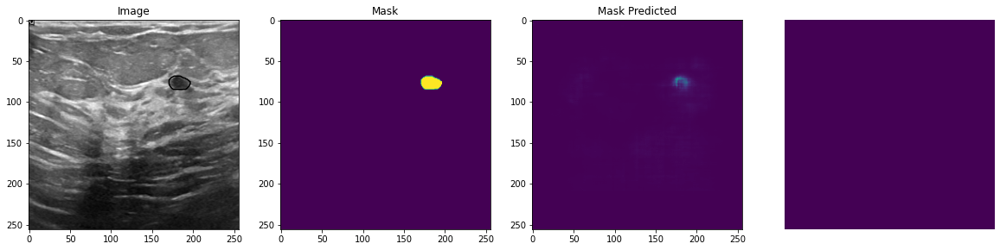

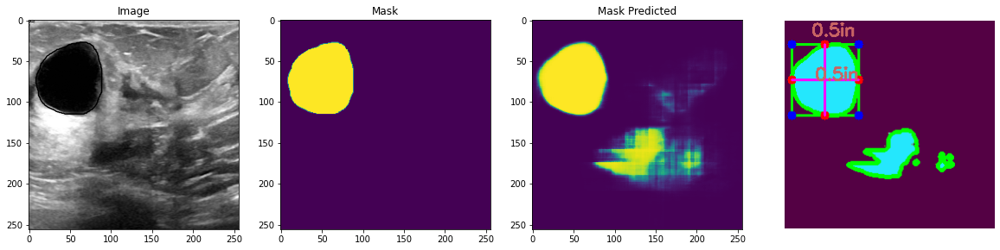

test image: 93
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.85906982421875
area ratio of mask predicted by model 2.837465564738292
[[48. 69.]
 [70. 69.]
 [70. 83.]
 [48. 83.]]
dimA 0.08917197452229299
dimB 0.14012738853503184


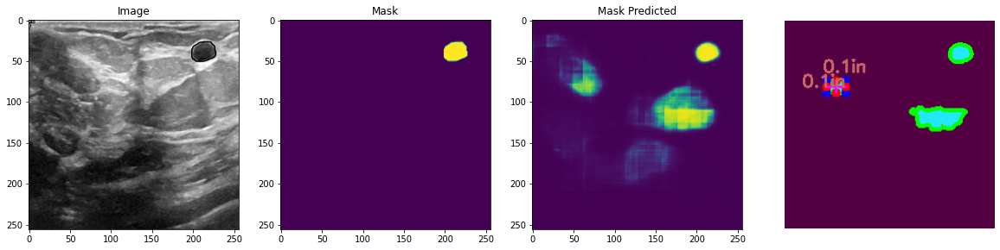

test image: 94
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 37.664794921875
area ratio of mask predicted by model 19.54028925619835
[[ 57.  27.]
 [191.  22.]
 [195. 145.]
 [ 61. 149.]]
dimA 0.7806706288153521
dimB 0.8539843210844325


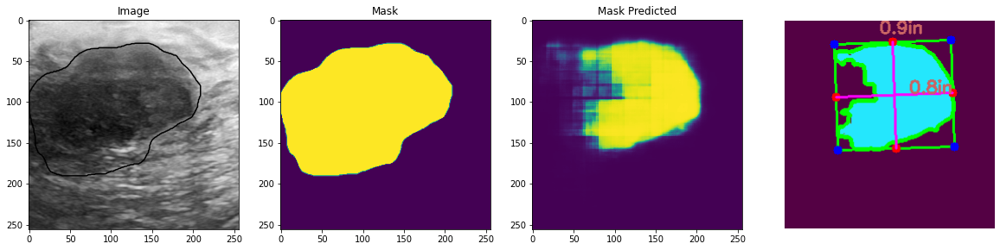

test image: 95
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.20391845703125
area ratio of mask predicted by model 0.9727961432506886
test image: 96
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.8328857421875
area ratio of mask predicted by model 6.324035812672177
[[ 36. 105.]
 [106.  86.]
 [124. 150.]
 [ 53. 170.]]
dimA 0.4256807555471952
dimB 0.4659051722383417


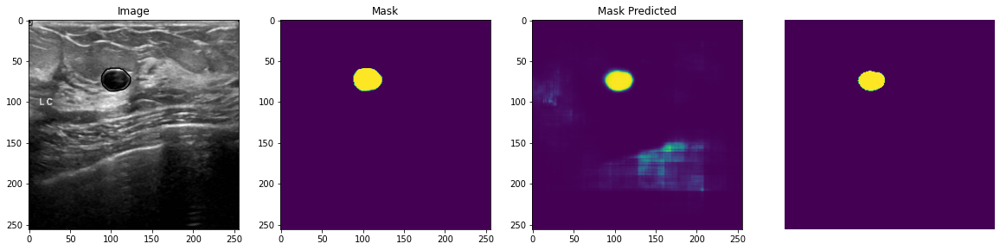

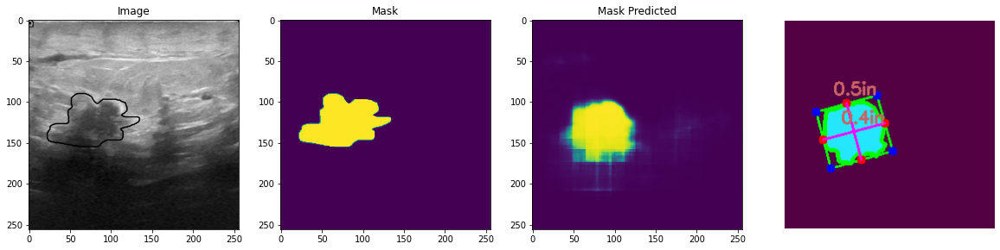

test image: 97
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 16.7572021484375
area ratio of mask predicted by model 14.543732782369146
[[ 49.  33.]
 [159.  33.]
 [159. 138.]
 [ 49. 138.]]
dimA 0.6687898089171974
dimB 0.7006369426751592


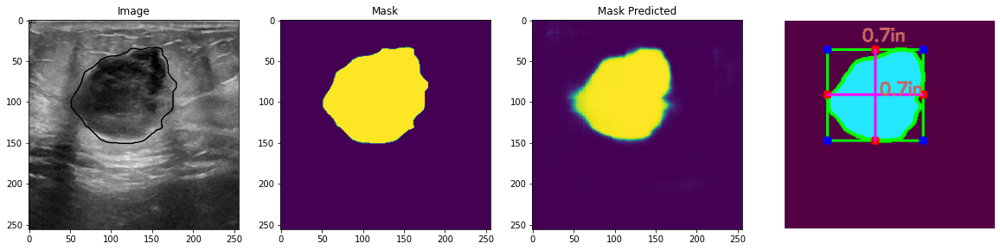

test image: 98
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.49591064453125
area ratio of mask predicted by model 0.7196969696969697
test image: 99
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.99835205078125
area ratio of mask predicted by model 1.8216253443526171
[[ 73.  13.]
 [110.  13.]
 [110.  53.]
 [ 73.  53.]]
dimA 0.25477707006369427
dimB 0.2356687898089172


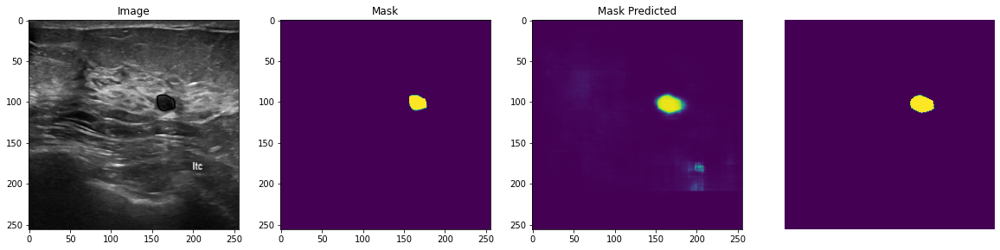

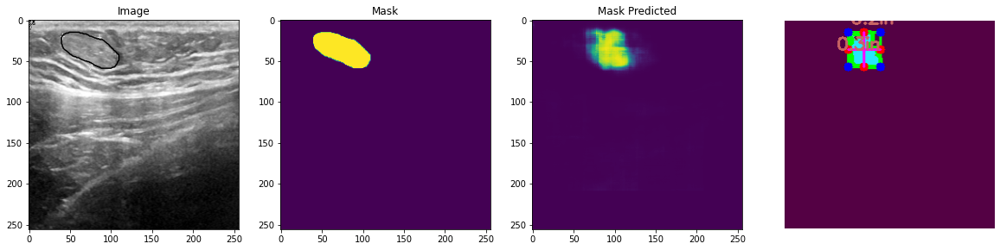

test image: 100
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.5552978515625
area ratio of mask predicted by model 1.7165977961432506
[[23. 29.]
 [52. 50.]
 [31. 81.]
 [ 1. 60.]]
dimA 0.24029290279793158
dimB 0.23064449756050837


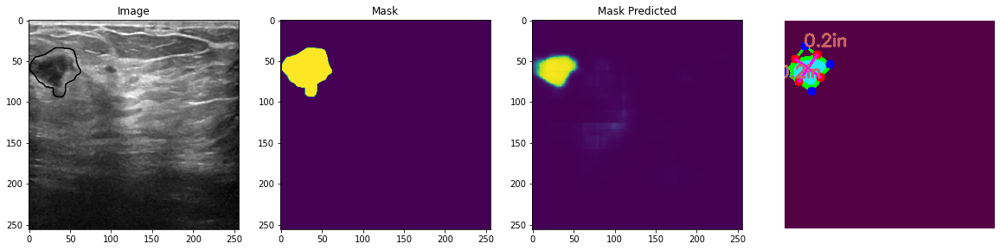

test image: 101
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.173828125
area ratio of mask predicted by model 4.008264462809917
[[162. 129.]
 [206.  66.]
 [238.  88.]
 [194. 151.]]
dimA 0.247343794126721
dimB 0.4894522153742198


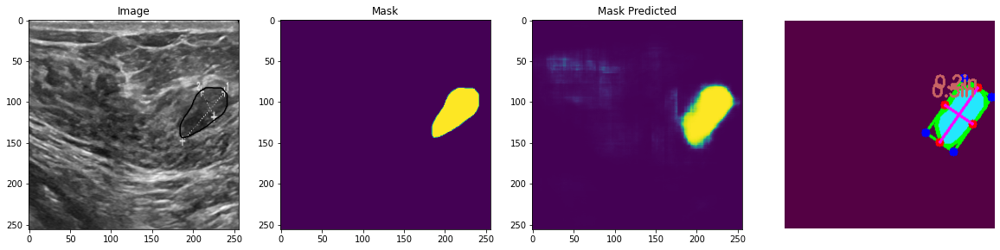

test image: 102
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.18511962890625
area ratio of mask predicted by model 11.75619834710744
[[ 56. 174.]
 [ 72. 197.]
 [ 60. 206.]
 [ 44. 183.]]
dimA 0.09554140127388536
dimB 0.17845765256206242


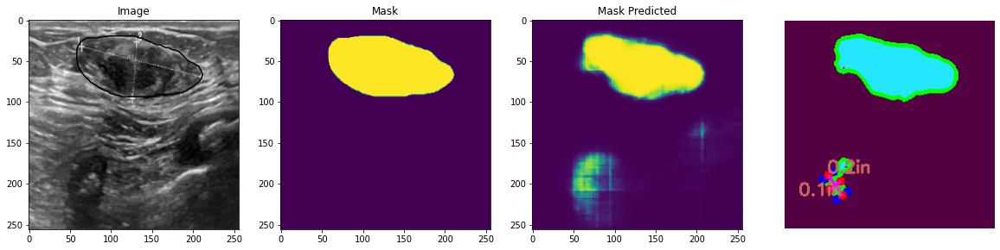

test image: 103
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.9622802734375
area ratio of mask predicted by model 1.6580578512396693
[[138.  54.]
 [179.  54.]
 [179.  82.]
 [138.  82.]]
dimA 0.17834394904458598
dimB 0.2611464968152866


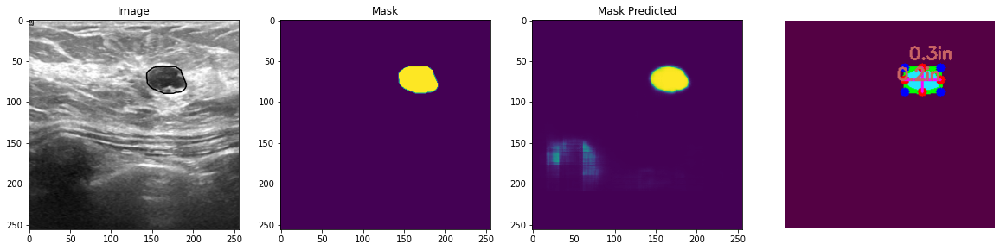

test image: 104
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.2974853515625
area ratio of mask predicted by model 8.706955922865014
[[ 55.  52.]
 [200.  39.]
 [205.  90.]
 [ 59. 102.]]
dimA 0.3229305644537164
dimB 0.9301653151399437


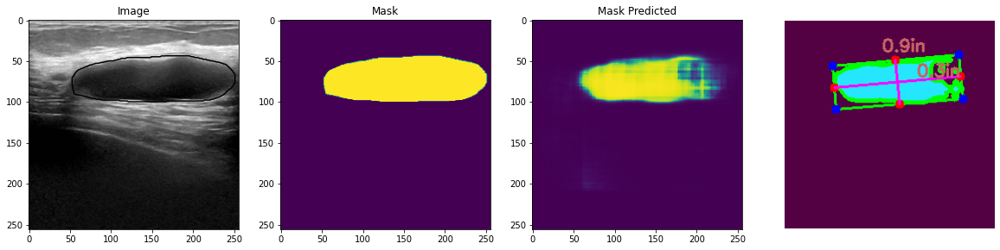

test image: 105
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.75067138671875
area ratio of mask predicted by model 14.6866391184573
[[ 60.  44.]
 [178.  18.]
 [198. 109.]
 [ 79. 134.]]
dimA 0.5896623884239167
dimB 0.7720549242358059


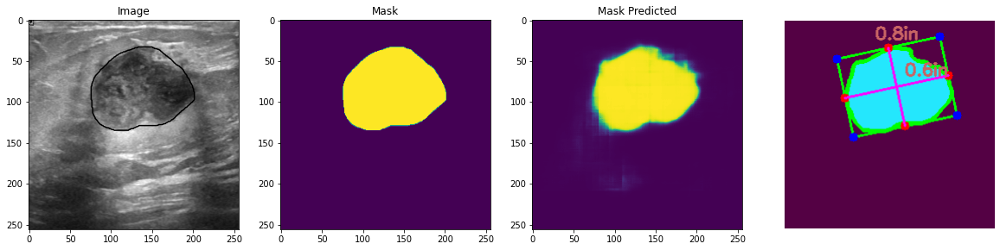

test image: 106
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 23.71826171875
area ratio of mask predicted by model 7.961432506887052
[[38. 73.]
 [60. 66.]
 [66. 83.]
 [44. 90.]]
dimA 0.11482647374089137
dimB 0.14704963542184962


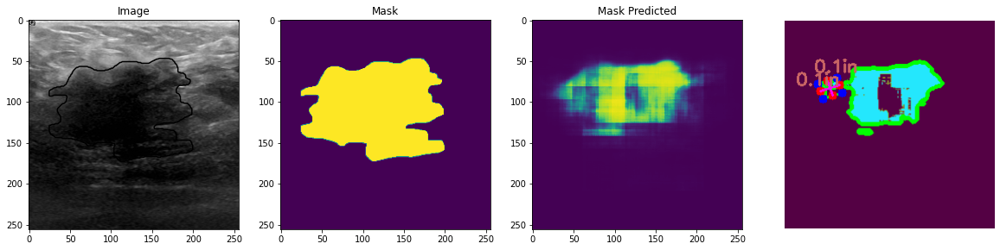

test image: 107
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.445556640625
area ratio of mask predicted by model 3.03202479338843
[[55. 31.]
 [99. 47.]
 [90. 71.]
 [46. 55.]]
dimA 0.1632612180633923
dimB 0.298208914922793


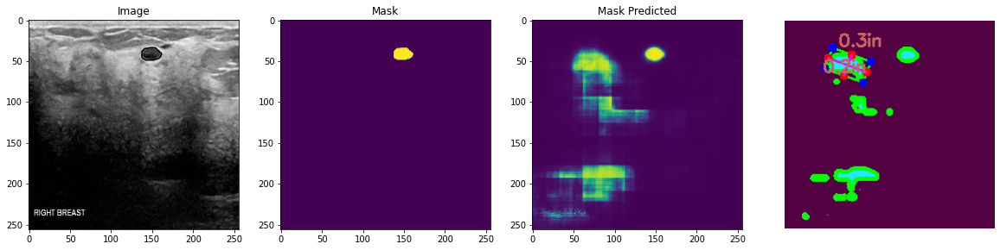

test image: 108
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.35943603515625
area ratio of mask predicted by model 100.0
test image: 109
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.89849853515625
area ratio of mask predicted by model 9.340564738292011
[[ 79.  17.]
 [131.  47.]
 [ 88. 123.]
 [ 35.  92.]]
dimA 0.5549996993828588
dimB 0.38672964700290136


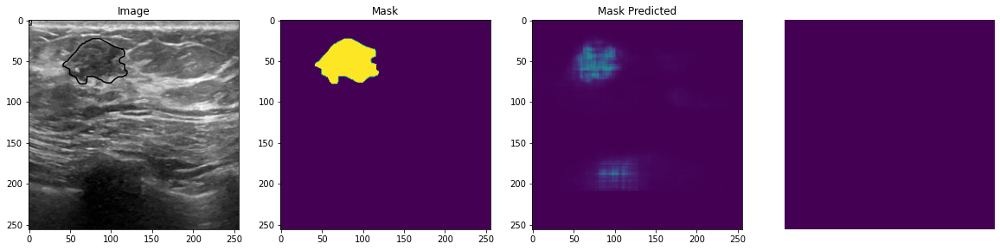

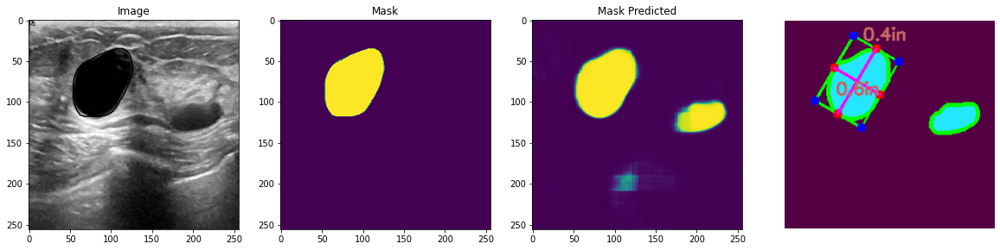

test image: 110
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.604248046875
area ratio of mask predicted by model 0.506198347107438
test image: 111
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.26922607421875
area ratio of mask predicted by model 2.4225206611570247
[[ 96.  74.]
 [146.  59.]
 [159. 100.]
 [109. 115.]]
dimA 0.2739594034090009
dimB 0.3324938378633933


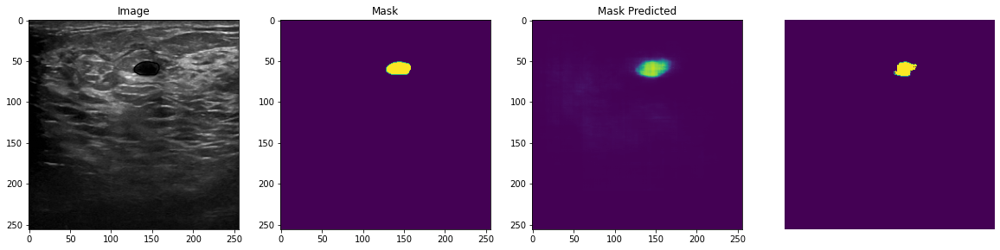

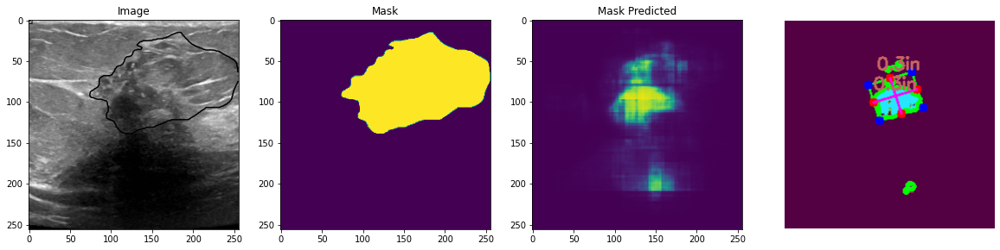

test image: 112
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.802490234375
area ratio of mask predicted by model 3.28168044077135
[[ 47. 119.]
 [108. 114.]
 [111. 154.]
 [ 50. 159.]]
dimA 0.25549262573416026
dimB 0.38983805727641674


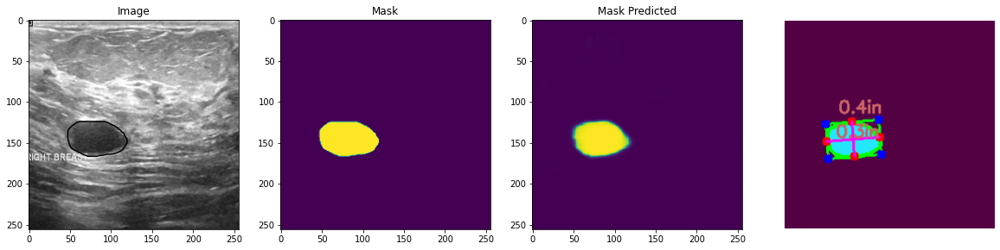

test image: 113
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.19146728515625
area ratio of mask predicted by model 6.701101928374656
[[ 64.  86.]
 [115.  57.]
 [153. 126.]
 [102. 154.]]
dimA 0.49894407549770403
dimB 0.3721211865124289


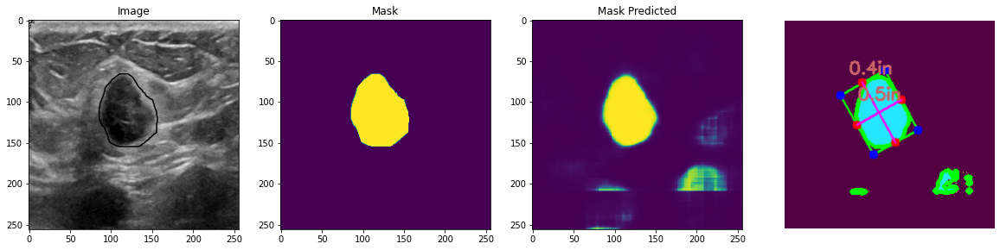

test image: 114
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 20.10498046875
area ratio of mask predicted by model 15.444214876033058
[[ 35.  50.]
 [215.  10.]
 [235. 103.]
 [ 55. 142.]]
dimA 0.6027864086225382
dimB 1.1737775178483112


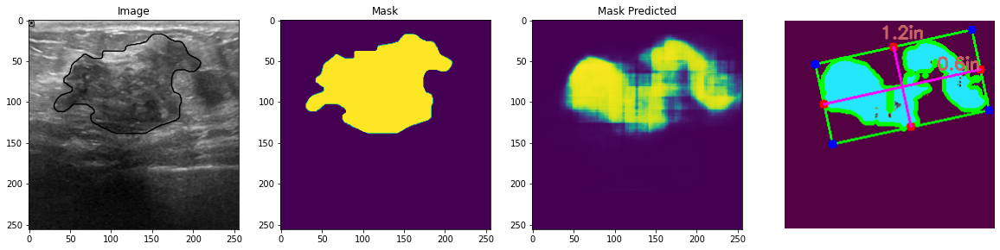

test image: 115
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.67083740234375
area ratio of mask predicted by model 5.198002754820936
[[ 93.  61.]
 [137.  61.]
 [137.  89.]
 [ 93.  89.]]
dimA 0.17834394904458598
dimB 0.2802547770700637


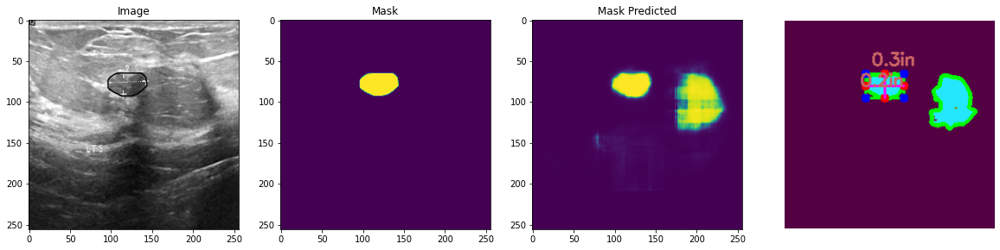

test image: 116
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.98114013671875
area ratio of mask predicted by model 0.8626033057851239
test image: 117
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.884521484375
area ratio of mask predicted by model 12.667011019283747
[[ 21.  40.]
 [139.  40.]
 [139. 122.]
 [ 21. 122.]]
dimA 0.5222929936305732
dimB 0.7515923566878981


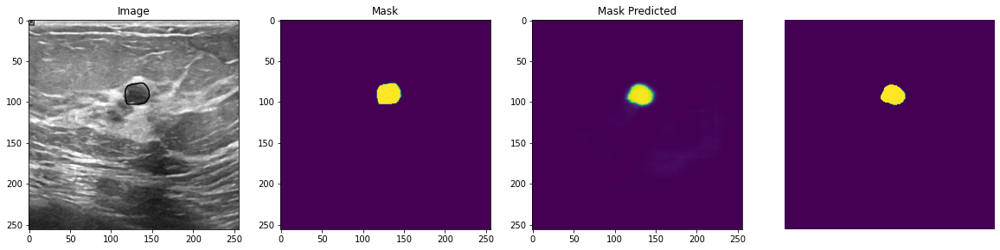

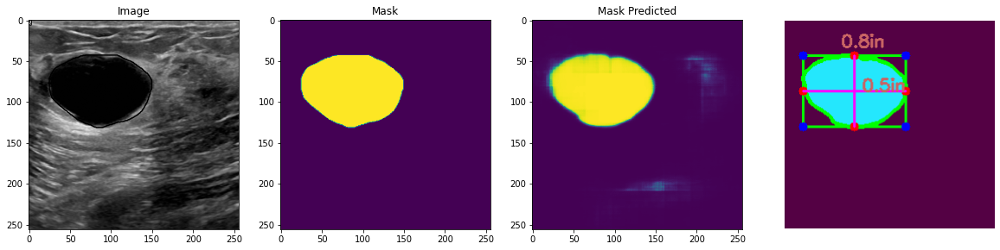

test image: 118
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.7847900390625
area ratio of mask predicted by model 13.59331955922865
[[  0. 123.]
 [ 87.  52.]
 [142. 118.]
 [ 54. 190.]]
dimA 0.5476410748713827
dimB 0.7197311311398804


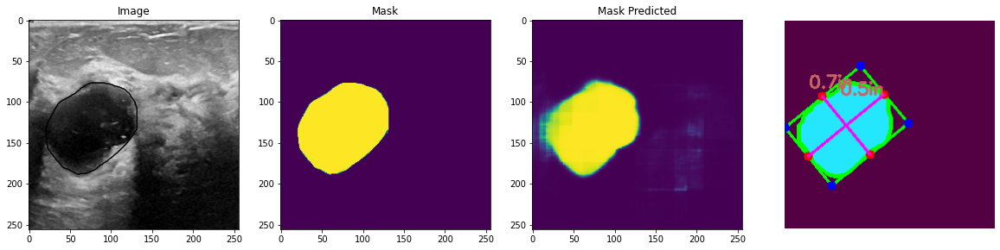

test image: 119
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.98272705078125
area ratio of mask predicted by model 0.8143939393939394
test image: 120
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.56585693359375
area ratio of mask predicted by model 6.131198347107438
[[ 99.  53.]
 [201.  65.]
 [195. 117.]
 [ 93. 105.]]
dimA 0.3334077026319083
dimB 0.6541621440238353


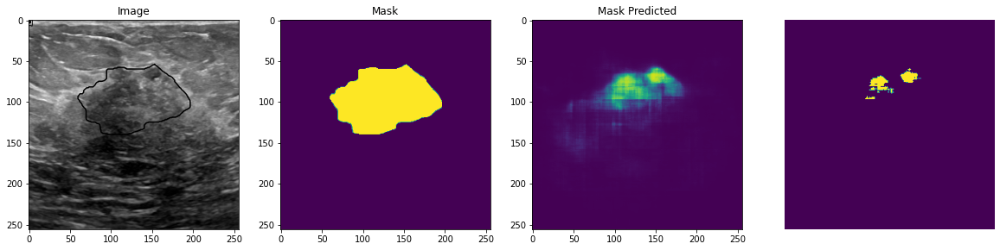

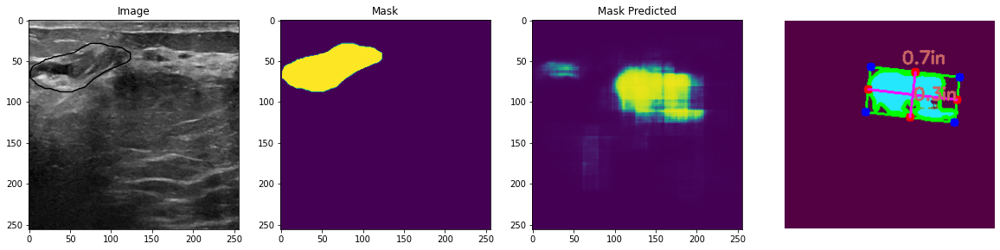

test image: 121
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 19.50836181640625
area ratio of mask predicted by model 14.31646005509642
[[ 62.  60.]
 [201.  72.]
 [192. 167.]
 [ 54. 155.]]
dimA 0.6075127715672713
dimB 0.8854705962381272


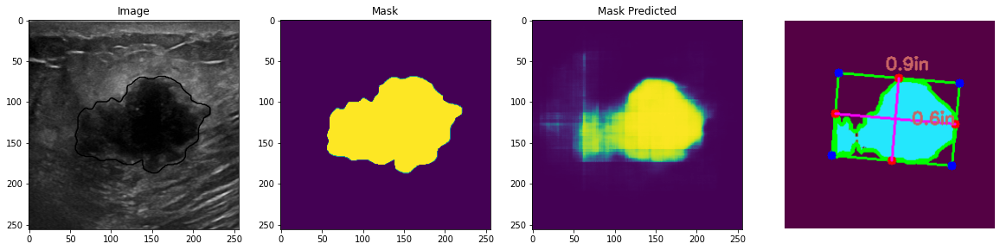

test image: 122
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 10.6689453125
area ratio of mask predicted by model 21.66322314049587
[[ 18.  22.]
 [199.  10.]
 [206. 124.]
 [ 26. 136.]]
dimA 0.7276843576176923
dimB 1.1522194406172295


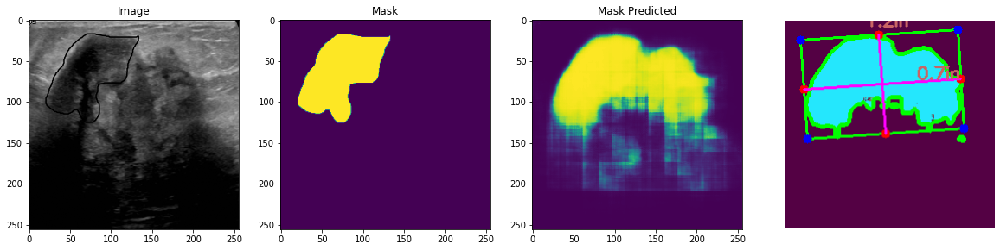

test image: 123
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.81207275390625
area ratio of mask predicted by model 100.0
test image: 124
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.75836181640625
area ratio of mask predicted by model 0.5853994490358126
test image: 125
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.20172119140625
area ratio of mask predicted by model 5.798898071625344
[[ 53. 114.]
 [ 62. 114.]
 [ 62. 157.]
 [ 53. 157.]]
dimA 0.27388535031847133
dimB 0.05732484076433121


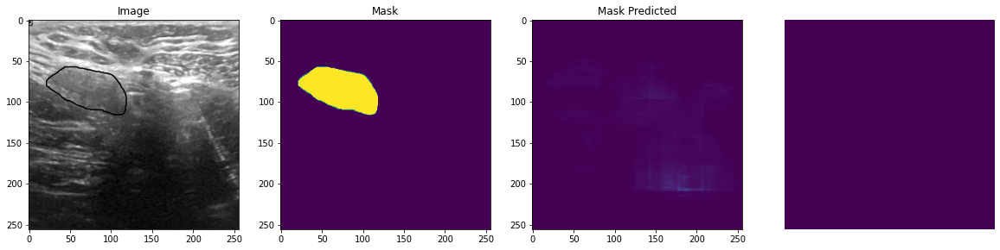

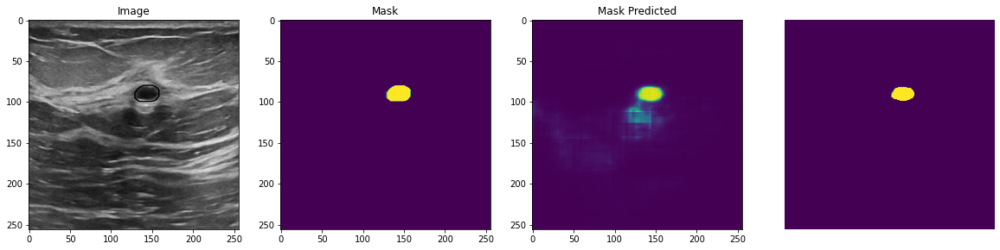

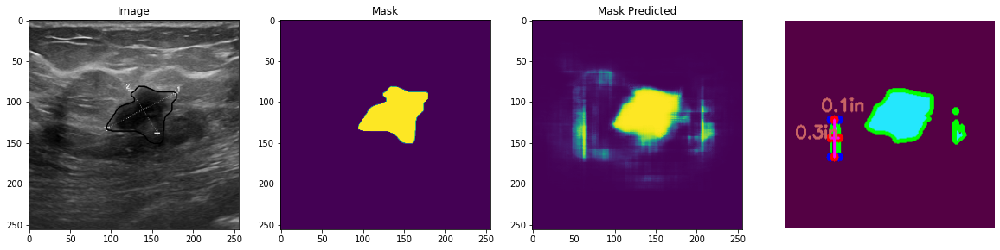

test image: 126
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.94744873046875
area ratio of mask predicted by model 0.26170798898071623
test image: 127
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 20.80535888671875
area ratio of mask predicted by model 8.87568870523416
[[ 68.  83.]
 [130.  43.]
 [150.  75.]
 [ 88. 115.]]
dimA 0.2403562071861555
dimB 0.469958388425394


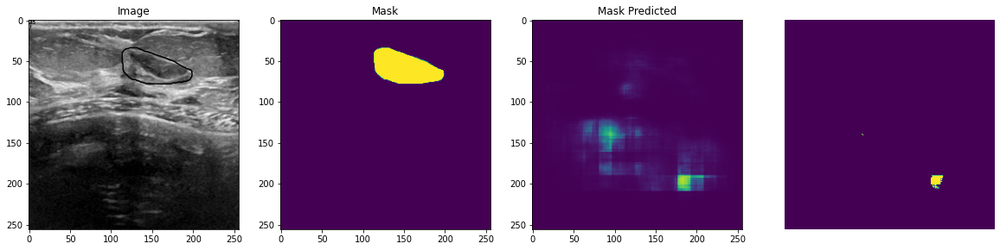

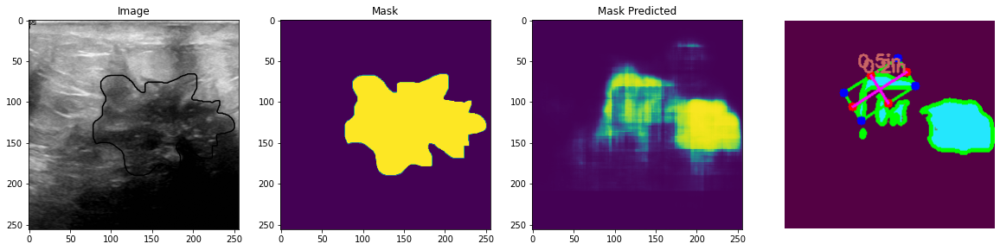

test image: 128
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 26.41754150390625
area ratio of mask predicted by model 3.028581267217631
[[ 48.  24.]
 [102.  24.]
 [102.  58.]
 [ 48.  58.]]
dimA 0.21656050955414013
dimB 0.34394904458598724


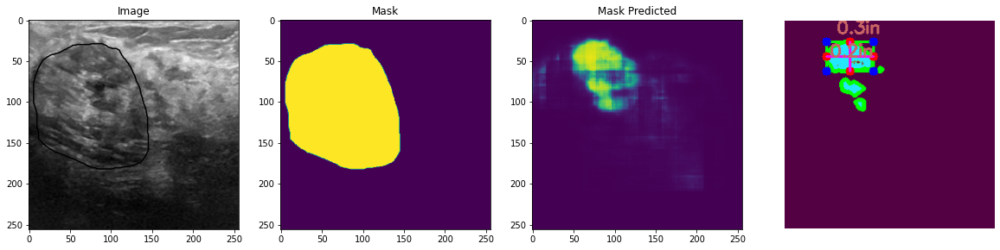

test image: 129
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.02764892578125
area ratio of mask predicted by model 17.09710743801653
[[ 48. -18.]
 [221.  97.]
 [175. 165.]
 [  2.  50.]]
dimA 0.5229140318923259
dimB 1.3231554690012342


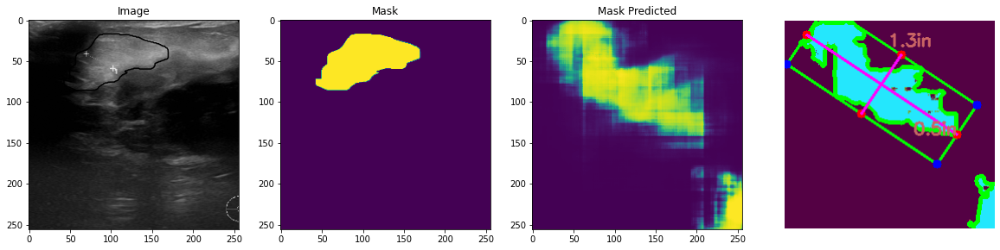

In [72]:

for i in range (0,len(X_valid)):
    plot_sample4(X_valid, y_valid, preds_test, preds_test_t,i)

df_final.to_csv(r'C:\Users\Jaya Tiwari\OneDrive\Documents\final_prj\base_unet.csv')

In [165]:
# create a dataframe from the lists
df= pd.DataFrame(data=zip(index,area_ratio_mask,area_ratio_pred_mask,length,width,top_right,top_left,bottom_right,bottom_left), 
                 columns=['index','white_pixel_area_ratio_mask','white_pixel_area_ratio_pred_mask','length_recBox',
'width_recBox',
'top_right_coor_rec',
'top_left_coor_rec',
'bottom_right_coor_rec',
'bottom_left_coor_rec'])

In [166]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]"
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]"
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]"
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]"
...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]"
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]"
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]"
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]"


In [167]:
# df.sort_values(by = 'white_pixel_area_ratio_pred_mask', inplace = True)

In [168]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]"
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]"
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]"
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]"
...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]"
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]"
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]"
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]"


In [169]:
# Differential Analysis steps

In [170]:
df['diff_area_ratio_pred'] = df['white_pixel_area_ratio_pred_mask']- df['white_pixel_area_ratio_pred_mask'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]",NaN
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]",30.633609
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]",69.116736
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072
...,...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]",16.702824
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]",-18.567493
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]",5.351240
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]",8.219697


In [171]:
df['diff_area_ratio_pred']=df['diff_area_ratio_pred'].replace(to_replace=np.NaN,value=0)
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]",0.000000
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]",30.633609
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]",69.116736
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072
...,...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]",16.702824
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]",-18.567493
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]",5.351240
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]",8.219697


In [172]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 10 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   index                             99 non-null     int64  
 1   white_pixel_area_ratio_mask       99 non-null     float64
 2   white_pixel_area_ratio_pred_mask  99 non-null     float64
 3   length_recBox                     99 non-null     float64
 4   width_recBox                      99 non-null     float64
 5   top_right_coor_rec                99 non-null     object 
 6   top_left_coor_rec                 99 non-null     object 
 7   bottom_right_coor_rec             99 non-null     object 
 8   bottom_left_coor_rec              99 non-null     object 
 9   diff_area_ratio_pred              99 non-null     float64
dtypes: float64(5), int64(1), object(4)
memory usage: 7.9+ KB


#mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
index = []
def save_file(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #fig, ax = plt.subplots(1, 1, figsize=(20, 10))
    #cv2.imshow('binary_preds', binary_preds[ix])
    #cv2.imwrite('./thresh.png',binary_preds[ix])
    plt.imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    binary_preds[ix].axis('off')
    plt.savefig(out_path,pad_inches=0)
    image1 = cv2.imread('b.png')
    image1 = np.array(image1)
    image1.shape
    # image1 = cv2.imread('thresh.png')
    len1,wid,tl,tr,bl,br = object_opencv(image1)
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)
    index.append(i)
    

for i in range (0,len(X_valid)):
    save_file(X_valid, y_valid, preds_test, preds_test_t,ix=i)

def plot_sample2(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #img = y[ix]
    #fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    #ax[0].imshow(X[ix])
    #if has_mask:
    #    ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    #ax[0].set_title('Image')

    #ax[1].imshow(y[ix].squeeze())
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    #ax[1].set_title('Mask')
    #len,wid,tl,tr,bl,br = object(y[ix])
    #ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    #ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[2].set_title('Mask Predicted')
    
    #ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[3].set_title('Mask Predicted binary');
    

    len,wid,tl,tr,bl,br = object_opencv(binary_preds[ix])
    #len,wid,tl,tr,bl,br = object_opencv(binary_preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)
    index.append(i)

mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
index = []
for i in range (0,len(X_valid)):
    plot_sample2(X_valid, y_valid, preds_test, preds_test_t,ix=i)
    

mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
for img in glob.glob("C://Users//Jaya Tiwari//OneDrive//Documents//final_prj//mask_img_diff_ana//*.png"):
    image= cv2.imread(img)
    mask_img.append(img)
    len,wid,tl,tr,bl,br = object(image)
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)

In [173]:
import pandas as pd

In [174]:
# calculating area of the tumour (area = length* width)
df['Area_recBox'] = df['length_recBox'] * df['width_recBox']

In [175]:
df['diff_analysis_recBox'] = df['Area_recBox']- df['Area_recBox'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]",0.000000,1.138160,NaN
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]",30.633609,0.424277,-0.713883
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]",69.116736,0.564567,0.140290
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083
...,...,...,...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]",16.702824,0.838452,0.300517
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]",-18.567493,0.015700,-0.822752
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]",5.351240,0.112957,0.097257
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]",8.219697,0.074486,-0.038472


In [176]:
df['diff_analysis_recBox']=df['diff_analysis_recBox'].replace(to_replace=np.NaN,value=0)
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox
0,0,7.168579,0.249656,0.768051,1.481881,"[244.0, 15.0]","[11.0, 7.0]","[239.0, 136.0]","[7.0, 127.0]",0.000000,1.138160,0.000000
1,1,31.004333,30.883264,0.528662,0.802548,"[189.0, 45.0]","[63.0, 45.0]","[189.0, 128.0]","[63.0, 128.0]",30.633609,0.424277,-0.713883
2,2,8.526611,100.000000,0.452229,1.248408,"[234.0, 19.0]","[38.0, 19.0]","[234.0, 90.0]","[38.0, 90.0]",69.116736,0.564567,0.140290
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083
...,...,...,...,...,...,...,...,...,...,...,...,...
94,94,37.664795,19.540289,0.727684,1.152219,"[199.0, 10.0]","[18.0, 22.0]","[206.0, 124.0]","[26.0, 136.0]",16.702824,0.838452,0.300517
95,95,1.203918,0.972796,0.273885,0.057325,"[62.0, 114.0]","[53.0, 114.0]","[62.0, 157.0]","[53.0, 157.0]",-18.567493,0.015700,-0.822752
96,96,6.832886,6.324036,0.240356,0.469958,"[130.0, 43.0]","[68.0, 83.0]","[150.0, 75.0]","[88.0, 115.0]",5.351240,0.112957,0.097257
97,97,16.757202,14.543733,0.216561,0.343949,"[102.0, 24.0]","[48.0, 24.0]","[102.0, 58.0]","[48.0, 58.0]",8.219697,0.074486,-0.038472


In [177]:
df.shape

(99, 12)

In [178]:
df = df.loc[[3,39,27,4]]

In [179]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069
39,39,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738
27,27,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083


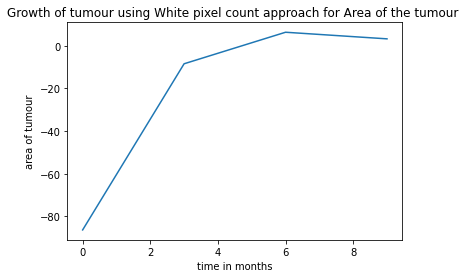

In [180]:
x = np.arange(0, 12, 3)
y = df['diff_area_ratio_pred']
plt.xlabel('time in months')
plt.ylabel('area of tumour')
plt.title('Growth of tumour using White pixel count approach for Area of the tumour ')
plt.plot(x, y)

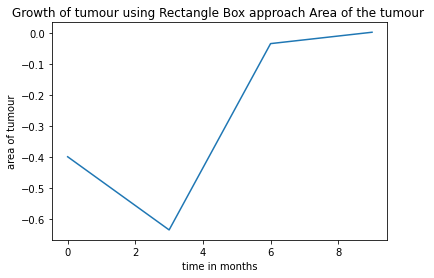

In [181]:
x = np.arange(0, 12, 3)
y = df['diff_analysis_recBox']
plt.xlabel('time in months')
plt.ylabel('area of tumour')
plt.title('Growth of tumour using Rectangle Box approach Area of the tumour ')
plt.plot(x, y)

In [182]:
# to find the direction of progression of tumour using rectangle Box approach

In [183]:
df['change in top_left points'] = df['top_left_coor_rec']- df['top_left_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069,"[nan, nan]"
39,39,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738,"[-29.0, 4.0]"
27,27,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545,"[65.0, 16.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083,"[-36.0, -22.0]"


In [184]:
df['change in top_right points'] = df['top_right_coor_rec']- df['top_right_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069,"[nan, nan]","[nan, nan]"
39,39,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738,"[-29.0, 4.0]","[-48.0, 4.0]"
27,27,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545,"[65.0, 16.0]","[38.0, 17.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083,"[-36.0, -22.0]","[10.0, -23.0]"


In [185]:
df['change in bottom_right points'] = df['bottom_right_coor_rec']- df['bottom_right_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069,"[nan, nan]","[nan, nan]","[nan, nan]"
39,39,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738,"[-29.0, 4.0]","[-48.0, 4.0]","[-48.0, -12.0]"
27,27,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545,"[65.0, 16.0]","[38.0, 17.0]","[36.0, 19.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083,"[-36.0, -22.0]","[10.0, -23.0]","[12.0, -8.0]"


In [186]:
df['change in bottom_left points'] = df['bottom_left_coor_rec']- df['bottom_left_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points,change in bottom_left points
3,3,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069,"[nan, nan]","[nan, nan]","[nan, nan]","[nan, nan]"
39,39,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738,"[-29.0, 4.0]","[-48.0, 4.0]","[-48.0, -12.0]","[-29.0, -12.0]"
27,27,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545,"[65.0, 16.0]","[38.0, 17.0]","[36.0, 19.0]","[63.0, 18.0]"
4,4,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083,"[-36.0, -22.0]","[10.0, -23.0]","[12.0, -8.0]","[-34.0, -7.0]"


In [187]:
df.loc[0,'change in top_left points']=np.zeros([2,1])

In [188]:
df.loc[0,'change in top_right points']=np.zeros([2,1])

In [189]:
df.loc[0,'change in bottom_right points']=np.zeros([2,1])

In [190]:
df.loc[0,'change in bottom_left points']=np.zeros([2,1])

In [191]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points,change in bottom_left points
3,3.0,13.731384,13.710399,0.343949,0.484076,"[209.0, 28.0]","[133.0, 28.0]","[209.0, 82.0]","[133.0, 82.0]",-86.289601,0.166498,-0.398069,"[nan, nan]","[nan, nan]","[nan, nan]","[nan, nan]"
39,39.0,9.146118,7.858127,0.242038,0.363057,"[161.0, 32.0]","[104.0, 32.0]","[161.0, 70.0]","[104.0, 70.0]",-8.410813,0.087874,-0.633738,"[-29.0, 4.0]","[-48.0, 4.0]","[-48.0, -12.0]","[-29.0, -12.0]"
27,27.0,8.695984,7.568871,0.255095,0.191189,"[199.0, 49.0]","[169.0, 48.0]","[197.0, 89.0]","[167.0, 88.0]",6.367080,0.048771,-0.033545,"[65.0, 16.0]","[38.0, 17.0]","[36.0, 19.0]","[63.0, 18.0]"
4,4.0,14.512634,16.983471,0.350318,0.484076,"[209.0, 26.0]","[133.0, 26.0]","[209.0, 81.0]","[133.0, 81.0]",3.273072,0.169581,0.003083,"[-36.0, -22.0]","[10.0, -23.0]","[12.0, -8.0]","[-34.0, -7.0]"
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[0.0, 0.0]","[0.0, 0.0]","[0.0, 0.0]","[0.0, 0.0]"


In [192]:
x_tl=[]
y_tl=[]
for i in range (0, df.shape[0]):
    x_tl.append(df['change in top_left points'][i][0])
    y_tl.append(df['change in top_left points'][i][1])

KeyError: 1

In [193]:
x_tr=[]
y_tr=[]
for i in range (0, df.shape[0]):
    x_tr.append(df['change in top_right points'][i][0])
    y_tr.append(df['change in top_right points'][i][1])

KeyError: 1

In [194]:
x_bl=[]
y_bl=[]
for i in range (0, df.shape[0]):
    x_bl.append(df['change in bottom_left points'][i][0])
    y_bl.append(df['change in bottom_left points'][i][1])
plt.plot(x_bl,y_bl)

KeyError: 1

In [195]:
x_br=[]
y_br=[]
for i in range (0, df.shape[0]):
    x_br.append(df['change in bottom_right points'][i][0])
    y_br.append(df['change in bottom_right points'][i][1])
plt.plot(x_br,y_br)

KeyError: 1

In [196]:
df['x_tl'] = x_tl
df['y_tl'] = y_tl
df['x_tr'] = x_tr
df['y_tr'] = y_tr
df['x_br'] = x_br
df['y_br'] = y_br
df['x_bl'] = x_bl
df['y_bl'] = y_bl
df

ValueError: Length of values (1) does not match length of index (5)

In [ ]:
df.to_csv(r'C:\Users\Jaya Tiwari\OneDrive\Documents\final_prj\base_unet_final.csv')

In [ ]:
# VIsualization of the direction of progression of coordinates

In [ ]:
import matplotlib.pyplot as plt

plt.plot(x_tl, y_tl, label = "Top Left coordinates")
plt.plot(x_tr, y_tr, label = "Top Right coordinates")
plt.plot(x_br, y_br, label = "Bottom Right coordinates")
plt.plot(x_bl, y_bl, label = "Top Right coordinates")
plt.xlabel('x coordinates')
# Set the y axis label of the current axis.
plt.ylabel('y coordinates')
# Set a title of the current axes.
plt.title('Direction of progression of tumour ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

**Refernces**<br>
* https://medium.com/ai-salon/understanding-dice-loss-for-crisp-boundary-detection-bb30c2e5f62b
* https://machinelearningmastery.com/how-to-configure-image-data-augmentation-when-training-deep-learning-neural-networks/#:~:text=Image%20data%20augmentation%20is%20a,of%20images%20in%20the%20dataset.
* https://www.section.io/engineering-education/image-preprocessing-in-python/#:~:text=In%20this%20tutorial%2C%20we%20shall,used%20to%20preprocess%20image%20data.
* https://towardsdatascience.com/understanding-semantic-segmentation-with-unet-6be4f42d4b47


In [ ]:
df_new = df